In [131]:
import sys
def sizeof_fmt(num, suffix='B'):
    ''' by Fred Cirera,  https://stackoverflow.com/a/1094933/1870254, modified'''
    for unit in ['','Ki','Mi','Gi','Ti','Pi','Ei','Zi']:
        if abs(num) < 1024.0:
            return "%3.1f %s%s" % (num, unit, suffix)
        num /= 1024.0
    return "%.1f %s%s" % (num, 'Yi', suffix)

for name, size in sorted(((name, sys.getsizeof(value)) for name, value in locals().items()),
                         key= lambda x: -x[1])[:10]:
    print("{:>30}: {:>8}".format(name, sizeof_fmt(size)))

                     matrix_df:  3.5 GiB
                cell_counts_df: 42.5 MiB
                    Z_score_df: 42.5 MiB
                           _36: 42.5 MiB
             MERFISH_clustered: 41.4 MiB
                           _10: 41.4 MiB
     normalized_cell_counts_df: 38.5 MiB
                        Zscore: 38.5 MiB
                       temp_df: 38.5 MiB
                   post_adata5: 36.7 MiB


In [1]:
import pandas as pd
import shutil
from scvi.dataset import CsvDataset
import os
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from scvi.dataset import CortexDataset, RetinaDataset
from scvi.models import VAE
from scvi.inference import UnsupervisedTrainer
import pickle
import scanpy as sc
import anndata
import torch

[2020-01-17 16:05:16,958] INFO - scvi._settings | Added StreamHandler with custom formatter to 'scvi' logger.
/home/zach/miniconda3/envs/pytorch/lib/python3.6/site-packages/sklearn/utils/linear_assignment_.py:22: FutureWarning: The linear_assignment_ module is deprecated in 0.21 and will be removed from 0.23. Use scipy.optimize.linear_sum_assignment instead.
  FutureWarning)


In [2]:
codebook_pth = '/bigstore/GeneralStorage/Rob/merfish/MERFISH_analysis-master/mouse/Doug/Hippocampus/HippocampusCodebookFinalPass2.txt'
codewords = pd.read_csv(codebook_pth,skiprows=3)
codewords.columns = ['name', 'id', 'barcode']
binary = np.zeros((len(codewords),18))
for y,barcode in enumerate(codewords.barcode):
    for x,b in enumerate(str(barcode).zfill(18)):
        binary[y,x]=b
binary_df = pd.DataFrame(binary,index=list(codewords['name']))

In [8]:
class CompressedSensingClass(object):
    def __init__(self,matrix,latent,info_df,
                 metric='cell_type',
                 nblanks=None,
                 npos=50,
                 nbits=18,
                 ncpu=1,
                 pop_ncpu=1,
                 keepers=10,
                 mutation_rate=0.1,
                 offspring_number=0,
                 mutation_number=0,
                 k=100,
                 sample=1000,
                 survivors=[],
                 iterations=100,
                 base_path='',
                 color='r',
                 fresh=True,
                 verbose=True):
        self.metric = metric
        self.info_df = info_df
        self.cell_types = self.info_df.cell_type.unique()
        self.fresh = fresh
        self.verbose = verbose
        if base_path == '':
            base_path = os.path.join(os.getcwd(),'Results')
        self.base_path = base_path
        if not os.path.exists(self.base_path):
            os.mkdir(self.base_path)
        else:
            print('Found Existing Path\n',self.base_path)
            if self.fresh:
                print('base_path already exists and will be overwritten')
                shutil.rmtree(self.base_path)
                os.mkdir(self.base_path)
            else:
                print('loading dict from file isnt supported yet')
        self.cells = list(matrix.columns)
        self.ncells = len(self.cells)
        if nblanks==None:
            nblanks = npos
        blanks = pd.DataFrame(np.zeros((nblanks,self.ncells)),index=['blank'+str(i)for i in range(nblanks)],columns=self.cells)
        self.matrix = pd.concat([matrix,blanks])
        self.gene_variance = np.std(self.matrix ,axis=1)
        self.nblanks = nblanks
        del matrix
        self.genes = list(self.matrix.index)
        self.ngenes = len(self.genes)
        self.npos = npos
        self.nbits = nbits
        self.ncpu = ncpu
        self.pop_ncpu = pop_ncpu
        self.keepers = keepers
        self.ideal = np.zeros(self.ngenes)
        self.ideal[0:npos] = 1
        self.ideal = list(self.ideal)
        self.mutation_rate = mutation_rate
        self.offspring_number = offspring_number
        self.mutation_number = mutation_number
        self.k = k # could infer
        self.sample = sample
        self.survivors = survivors
        self.iterations = iterations
        self.color = color

    def generate_random(self):
        species = np.zeros((self.ngenes,self.nbits))
        for i in range(self.nbits):
            x = random.sample(list(range(self.ngenes)),self.npos)
            species[x,i] = 1
        return species

    def generate_starting_survivors(self):
        survivors = []
        for k in range(self.keepers):
            survivors.append(self.generate_random())
        self.survivors = survivors

    def generate_mutations(self,species):
        mutated = species.copy()
        for y in range(self.nbits):
            for x in random.sample(list(range(self.ngenes)),int(self.mutation_rate*self.ngenes)):
                mutated[x,y] = random.sample(self.ideal,1)[0]
        return mutated

    def generate_offspring(self,species,mate):
        offspring = species.copy()
        for y in range(self.nbits):
            for x in random.sample(list(range(self.ngenes)),int(self.ngenes/2)):
                offspring[x,y] = mate[x,y]
        return offspring

    def generate_progenerators(self):
        progenerators = self.survivors.copy()
        for species in self.survivors:
            for i in range(self.offspring_number):
                mate = self.survivors[random.randint(0,self.keepers-1)].copy()
                progenerators.append(self.generate_offspring(species,mate))
        self.progenerators = progenerators

    def pfunc_generate_mutations(self,species):
        ppopulation = []
        for i in range(self.mutation_number):
            ppopulation.append(self.generate_mutations(species))
        return ppopulation

    def generate_population(self):
        population = self.progenerators.copy()
        if self.mutation_number>0:
            if self.pop_ncpu==1:
                for species in self.progenerators:
                    for i in range(self.mutation_number):
                        population.append(self.generate_mutations(species))
            else:
                sys.stdout.flush()
                with Pool(self.pop_ncpu) as p:
                    for ppopulation in p.imap(self.pfunc_generate_mutations,self.progenerators,chunksize=1):
                        for species in ppopulation:
                            population.append(species)
                sys.stdout.flush()
        self.population = population

    def generate_compressed(self,species):
        compressed = pd.DataFrame(index=self.cells)
        temp_matrix = np.array(self.matrix)
        out = []
        for i in range(self.nbits):
            compressed[i] = np.sum(np.multiply(temp_matrix,species[:,i][...,None]),axis=0)
        return compressed

    def calculate_metric(self,compressed):
        X = np.array(compressed.copy())
        cells = np.array(self.cells)
        n = random.sample(list(range(self.ncells)),int(self.sample*self.ncells))
        dist = euclidean_distances(X, X[n,:])
        rank = dist.argpartition(self.k+1,axis=0)[:self.k+1,:]
        metrics = []
        correlations = []
        for i,idx in enumerate(n):
            cell = cells[idx]
            knn = cells[rank[:,i]]
            knn = knn[knn!=cell]
            sig = self.matrix[cell]
            avg = np.average(self.matrix[knn[1:]],axis=1)
            correlation = spearmanr(sig,avg)[0]
            if self.metric =='imputation':
                metric = 1-np.nanmean(np.abs((sig-avg)/self.gene_variance))
            elif self.metric == 'cell_type':
                cell = self.info_df.loc[knn[0]].cell_type
                temp_df = self.info_df.loc[knn[1:]]
                metric = len(temp_df[temp_df.cell_type==cell])/self.k
            elif self.metric == 'dendogram':
                print('Not implemented')
#             metric = np.divide(np.sqrt(np.sum(np.square(np.subtract(sig,avg)))),self.nbits)
            correlation = spearmanr(sig,avg)[0]
            metrics.append(metric)
            correlations.append(correlation)
        metric = np.average(metrics)
        correlation = np.average(correlations)
        return metric,correlation

    def pfunc(self,species):
        compressed = self.generate_compressed(species)
        metric,correlation = self.calculate_metric(compressed)
        return species,compressed,metric,correlation
    
    def selection(self):
        new_population = []
        compresseds = []
        metrics = []
        correlations = []
        if self.ncpu==1:
            for species in tqdm.tqdm(self.population):
                species,compressed,metric,correlation = self.pfunc(species)
                new_population.append(species)
                compresseds.append(compressed)
                metrics.append(metric)
                correlations.append(correlation)
        else:
            sys.stdout.flush()
            with Pool(self.ncpu) as p:
                for species,compressed,metric,correlation in tqdm.tqdm(p.imap(self.pfunc,self.population,chunksize=1),total=len(self.population)):
                    new_population.append(species)
                    compresseds.append(compressed)
                    metrics.append(metric)
                    correlations.append(correlation)
            sys.stdout.flush()
        df = pd.DataFrame(index=range(len(self.population)))
        df['population'] = new_population
        df['metrics'] = metrics
        df['compresseds'] = compresseds
        df['correlations'] = correlations
        df = df.sort_values('metrics',ascending=False)
        survivors = df.iloc[:self.keepers]
        self.metrics = list(survivors['metrics'])
        self.compresseds = list(survivors['compresseds'])
        self.correlations = list(survivors['correlations'])
        self.survivors = list(survivors['population'])
        self.elite_survivor = self.survivors[0]
    
    def populate(self):
        self.generate_progenerators()
        self.generate_population()
            
    def evolve(self):
        start_time = time.time()
        self.X = []
        self.Y = []
        self.max = []
        self.min = []
        if len(self.survivors) != self.keepers:
            self.generate_starting_survivors()
        display.clear_output(wait=True)
        for I in range(self.iterations):
            if self.verbose:
                print('Iteration '+str(I))
            self.populate()
            self.selection()
            pickle.dump(self.elite_survivor,open(os.path.join(self.base_path,str('elite_survivor_'+str(I)+'.pkl')),'wb'))
            pickle.dump(self.survivors,open(os.path.join(self.base_path,str('survivors_'+str(I)+'.pkl')),'wb'))
            pickle.dump(self.metrics,open(os.path.join(self.base_path,str('metrics_'+str(I)+'.pkl')),'wb'))
            pickle.dump(self.compresseds,open(os.path.join(self.base_path,str('compresseds_'+str(I)+'.pkl')),'wb'))
            pickle.dump(self.correlations,open(os.path.join(self.base_path,str('correlations_'+str(I)+'.pkl')),'wb'))
            avg = np.average(self.metrics)
            std = np.std(self.metrics) 
            self.X.append((time.time()-start_time)/(60*60))
            self.Y.append(avg)
            self.max.append(avg+std)
            self.min.append(avg-std)
            if self.verbose:
#                 pl.plot(self.X,np.log10(self.Y),c='k',linewidth=1)
#                 pl.fill_between(self.X,np.log10(self.max),np.log10(self.min),color=self.color)
                pl.plot(self.X,self.Y,c='k',linewidth=1)
                pl.fill_between(self.X,self.max,self.min,color=self.color)
                if self.metric =='imputation':
                    pl.ylabel('Average Zscore')
                elif self.metric == 'cell_type':
                    pl.ylabel('Average % Accurate')
                elif self.metric == 'dendogram':
                    pl.ylabel('Average metric')
                pl.xlabel('Time Hours')
                display.clear_output(wait=True)
                display.display(pl.gcf())
            if I>10:
                if np.average(self.Y[-5:])==self.Y[-1]:
                    break
        if self.verbose:
            display.clear_output(wait=True)
            print('Average Correlation:',round(np.average(self.correlations),4))
            print('Standard Deviation:',round(np.std(self.correlations),4))


In [3]:
import pickle
import pandas as pd
matrix = pickle.load(open('/bigstore/binfo/mouse/Hippocampus/TBI.SHAM.countdata.with.celltypes.normalized.pkl','rb'))
latent = pd.read_csv('/bigstore/binfo/mouse/Hippocampus/TBI.SHAM.countdata.with.celltypes.latent.csv.gz',index_col=0)
genes = pd.read_csv('/bigstore/binfo/mouse/Hippocampus/TBI.SHAM.countdata.with.celltypes.genes.csv',index_col=0)
info_df = pd.read_csv('/bigstore/binfo/mouse/Hippocampus/TBI.SHAM.countdata.with.celltypes.info_df.csv',index_col=0)
matrix_df = pd.DataFrame(matrix.T,index=genes.index,columns=info_df.index)


In [11]:
# CSC = CompressedSensingClass(matrix_df,latent,info_df,
#                              npos=50,
#                              nbits=18,
#                              ncpu=30,
#                              pop_ncpu=30,
#                              keepers=10,
#                              mutation_rate=0.3,
#                              offspring_number=0,
#                              mutation_number=2,
#                              k=50,
#                              sample=0.05,
#                              survivors=[],
#                              iterations=100,
#                              base_path='/bigstore/GeneralStorage/Zach/CSI/test',
#                              color='r',
#                              fresh=True,
#                              verbose=True)

[2020-01-13 14:21:02,640] INFO - scvi._settings | Added StreamHandler with custom formatter to 'scvi' logger.
/home/zach/miniconda3/envs/pytorch/lib/python3.6/site-packages/sklearn/utils/linear_assignment_.py:22: FutureWarning: The linear_assignment_ module is deprecated in 0.21 and will be removed from 0.23. Use scipy.optimize.linear_sum_assignment instead.
  FutureWarning)


Found Existing Path
 /bigstore/GeneralStorage/Zach/CSI/test
base_path already exists and will be overwritten


In [4]:
variable_genes = list(matrix_df.index)
for i in list(codewords.name):
    if not i in variable_genes:
        print(i)

Arhgap45
Emsy
Epb41l4b
Zfp950


In [5]:
compressed = pd.DataFrame(index=matrix_df.columns)
probed_expression_matrix = matrix_df.loc[list(codewords.name)]
temp_matrix = np.array(probed_expression_matrix)
for i in range(18):
    compressed[i] = np.nansum(np.multiply(temp_matrix,binary[:,i][...,None]),axis=0)
scRNAseq_compressed = compressed

/home/zach/miniconda3/envs/pytorch/lib/python3.6/site-packages/ipykernel_launcher.py:2: FutureWarning: 
Passing list-likes to .loc or [] with any missing label will raise
KeyError in the future, you can use .reindex() as an alternative.

See the documentation here:
https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#deprecate-loc-reindex-listlike
  


In [6]:
matrix_df

,S1Hip_CCTTGCCACACT_ODC,S1Hip_TTCTATTCGTAG_ODC,S1Hip_TTGGGCCCACCG_ODC,S1Hip_ATGTACGCCGTG_ODC,S1Hip_CCAGAATAATTT_ODC,S1Hip_CCGCTCAAGTCC_ODC,S1Hip_GGAGGATTGGGT_ODC,S1Hip_AGTCACTGTTTA_ODC,S1Hip_TAAAACCTATCG_ODC,S1Hip_CCGTCCCGAGTT_ODC,...,TBI5Hip_TCCTGAGACGCT_EPEN,TBI5Hip_TTGCGCAAAACG_EPEN,TBI5Hip_ACGCCGAGTTGC_EPEN,TBI5Hip_CAGCATATGGCG_EPEN,TBI5Hip_GACATCATTCAT_EPEN,TBI5Hip_GGTATTGACACC_EPEN,TBI5Hip_TCCCACGCCAAC_EPEN,TBI5Hip_TTCCTGTAGACC_EPEN,TBI5Hip_ATTTAATTGAGC_EPEN,TBI5Hip_ATCCCTCGCAGC_EPEN
Reps1,4.432740e-05,3.627222e-05,3.204408e-05,4.988413e-05,4.400787e-05,6.379264e-05,4.613181e-05,5.982694e-05,3.018664e-05,4.897482e-05,...,2.705930e-05,7.052045e-05,4.239633e-05,6.270975e-05,7.923026e-05,3.409079e-05,5.083093e-05,4.029397e-05,4.255586e-05,2.297022e-05
Soga3,1.233983e-04,1.097830e-04,1.363549e-04,1.483357e-04,1.529769e-04,1.620846e-04,1.406424e-04,1.406503e-04,1.322850e-04,1.256736e-04,...,1.809963e-04,1.747574e-04,1.031361e-04,9.559583e-05,2.390540e-04,2.036348e-04,1.265044e-04,1.533321e-04,2.038386e-04,1.496775e-04
Rps15,6.180854e-04,5.289496e-04,5.716269e-04,4.918539e-04,5.250957e-04,6.916280e-04,5.511217e-04,4.586396e-04,4.771086e-04,4.842014e-04,...,2.142212e-04,1.825181e-04,3.559615e-04,2.827444e-04,9.291016e-05,1.865286e-04,2.646769e-04,3.318252e-04,2.181835e-04,4.299768e-04
Anks1b,4.593085e-04,5.221244e-04,6.097440e-04,5.430284e-04,5.316752e-04,5.219853e-04,5.633551e-04,4.753680e-04,5.485377e-04,5.268399e-04,...,8.583582e-05,2.406557e-04,1.182300e-04,1.056718e-04,8.480879e-05,1.177277e-04,1.084546e-04,1.252218e-04,9.968544e-05,1.248592e-04
Eea1,1.125073e-04,8.092835e-05,8.913188e-05,1.157198e-04,1.007362e-04,1.027714e-04,1.050855e-04,1.140152e-04,1.156729e-04,1.021141e-04,...,1.442493e-04,2.663250e-04,4.106371e-04,4.036101e-04,3.512182e-04,1.198819e-04,2.470003e-04,2.525159e-04,2.379561e-04,1.814376e-04
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
n-R5s71,8.738790e-08,5.260263e-08,1.100991e-07,1.649646e-07,1.576008e-07,1.178875e-07,1.527590e-07,1.133764e-07,1.150741e-07,6.734142e-08,...,9.821543e-08,2.345121e-07,1.835245e-07,1.975765e-07,6.644499e-07,1.217170e-07,2.739348e-07,2.203084e-07,2.640325e-07,1.415002e-07
n-R5s72,1.416731e-07,9.363143e-08,2.044398e-07,2.293474e-07,2.126984e-07,1.670513e-07,2.368086e-07,1.560554e-07,1.750501e-07,9.123282e-08,...,1.013619e-07,1.598492e-07,1.599808e-07,2.001169e-07,3.812818e-07,1.239600e-07,3.085906e-07,2.803942e-07,2.976626e-07,2.356798e-07
n-R5s85,6.507341e-08,6.681818e-08,8.606381e-08,1.145094e-07,1.172695e-07,1.022160e-07,1.233253e-07,8.700398e-08,7.066494e-08,6.033009e-08,...,8.611356e-08,2.294714e-07,1.329420e-07,1.444945e-07,8.077047e-07,1.351456e-07,2.648899e-07,1.948434e-07,2.192509e-07,1.061081e-07
n-R5s88,6.301876e-08,4.035592e-08,5.555229e-08,8.586078e-08,7.332150e-08,9.569283e-08,9.337936e-08,7.394263e-08,5.251262e-08,4.679222e-08,...,1.502261e-07,1.954536e-07,1.660250e-07,1.952317e-07,7.776285e-07,2.173128e-07,3.515418e-07,2.858181e-07,3.436750e-07,2.016047e-07


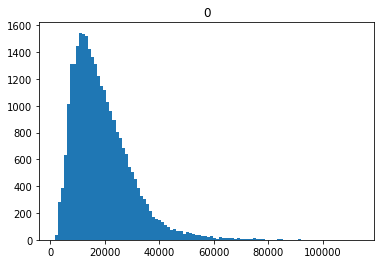

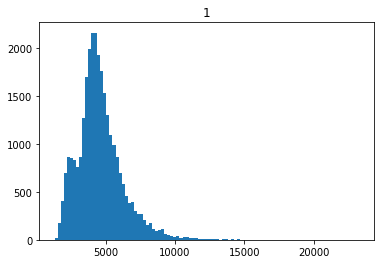

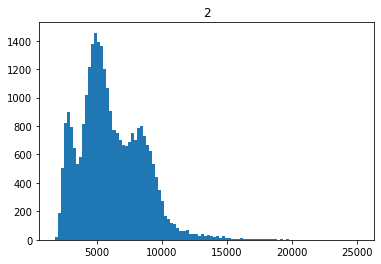

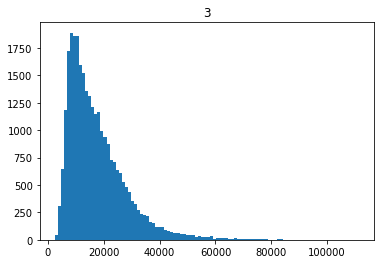

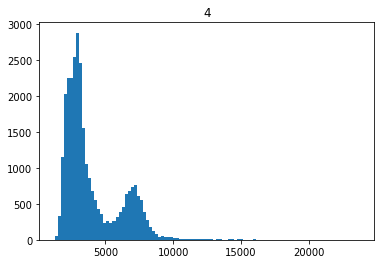

...

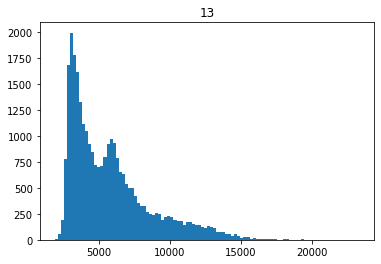

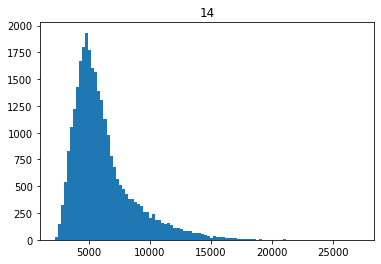

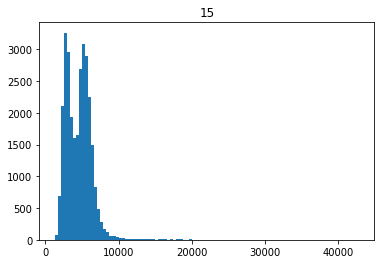

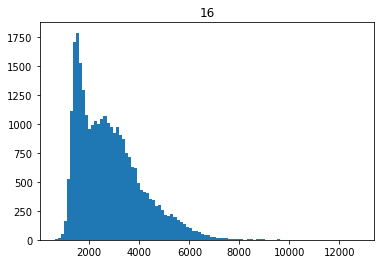

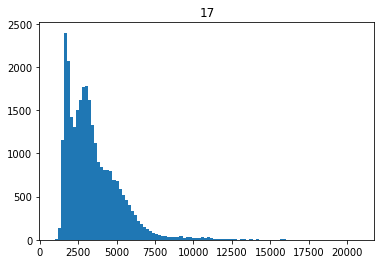

In [13]:
%matplotlib inline
for i in compressed.columns:
    plt.hist(compressed[i]*(10**6),bins=100)
    plt.title(i)
    plt.show()
    

In [10]:
MERFISH_clustered = pd.read_csv('/bigstore/GeneralStorage/Zach/CSI/MERFISH_clustered.csv.gz',index_col=0)
MERFISH_clustered

,z,Sema5a,Ttyh2,Tnfaip8l3,Cacna2d1,Ncan,Spry2,Epb41l4b,Fibcd1,Dyrk1a,...,Prox1,Grm2,Casp8,Plekha5,Selplg,stage_x,stage_y,pos,pixel_x,pixel_y
0,13.090909,0,0,0,3,5,2,1,1,17,...,0,0,0,0,0,6394.132364,1114.336273,Pos290,1707.636364,1773.727273
1,13.857143,6,1,0,1,12,2,4,0,6,...,0,0,0,0,0,5155.304571,1811.363929,Pos187,1956.922674,425.357143
2,14.000000,13,7,1,5,18,5,3,1,13,...,0,0,0,0,0,5346.885846,3366.115231,Pos214,1778.769231,1147.846154
3,7.250000,0,0,0,0,13,1,0,0,3,...,0,0,1,0,0,4844.659750,2783.026750,Pos173,1042.750000,1605.750000
4,16.266667,4,2,0,1,21,1,1,0,2,...,0,0,0,0,0,3902.601333,1870.788133,Pos103,143.131498,970.533333
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
29646,8.000000,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,4583.765000,-4521.144000,Pos145,585.000000,384.000000
29647,24.000000,0,8,0,0,0,1,1,0,0,...,0,0,0,0,0,4245.549667,-3334.871667,Pos117,1353.666667,1588.333333
29648,14.000000,0,0,0,6,3,2,0,36,9,...,0,0,0,0,0,4321.123000,-4665.586923,Pos111,2047.000000,994.615385
29649,20.000000,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,3846.495000,-4453.564000,Pos78,1555.000000,1004.000000


In [15]:
compressed = pd.DataFrame(index=MERFISH_clustered.index)
for i in range(18):
    genes = list(binary_df[binary_df[i]==1].index)
    compressed[i] = np.sum(MERFISH_clustered[genes],axis=1)
MERFISH_compressed = compressed

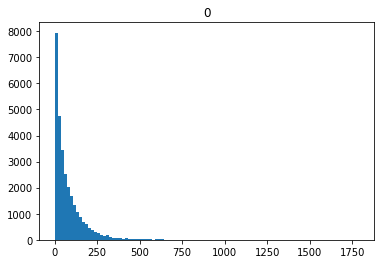

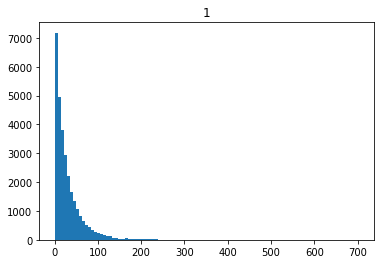

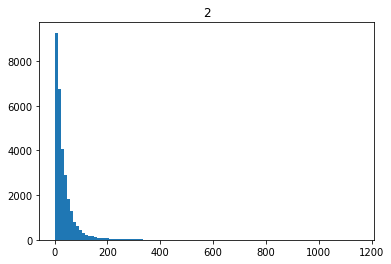

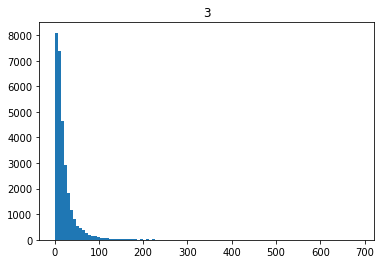

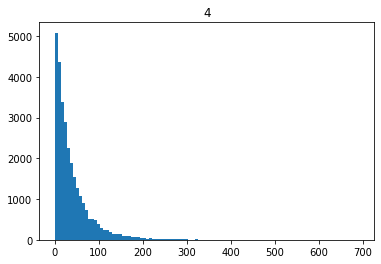

...

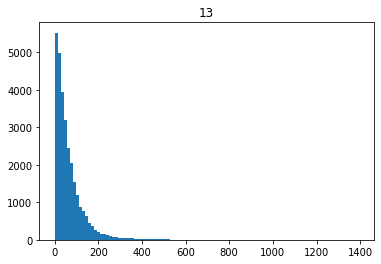

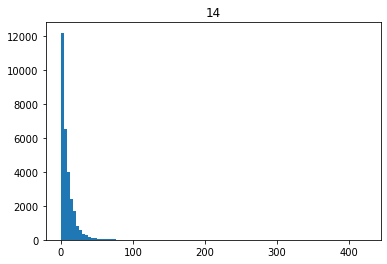

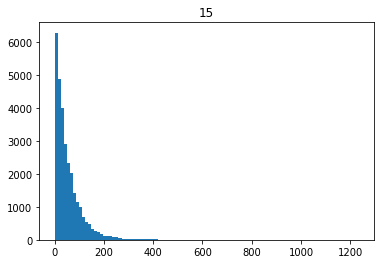

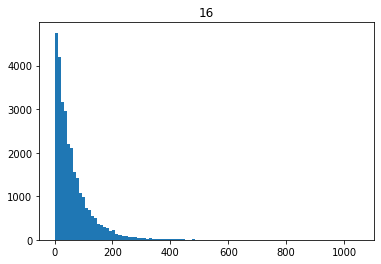

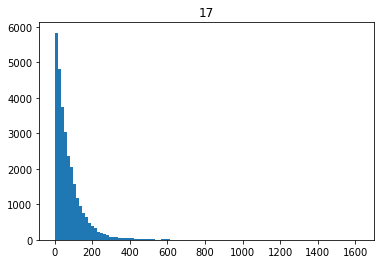

In [12]:
for i in binary_df.columns:
    genes = list(binary_df[binary_df[i]==1].index)
    plt.hist(np.sum(MERFISH_clustered[genes],axis=1),bins=100)
    plt.title(i)
    plt.show()

/home/zach/miniconda3/envs/pytorch/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: divide by zero encountered in log10
  # This is added back by InteractiveShellApp.init_path()


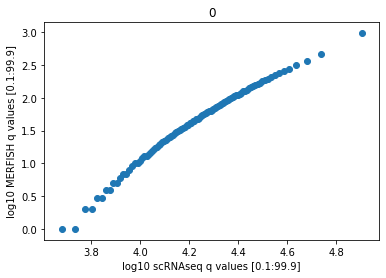

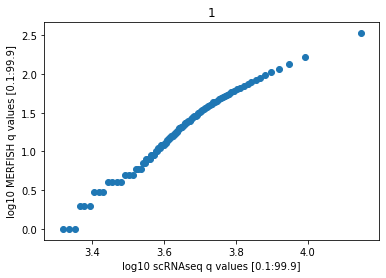

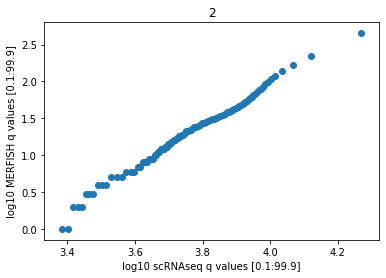

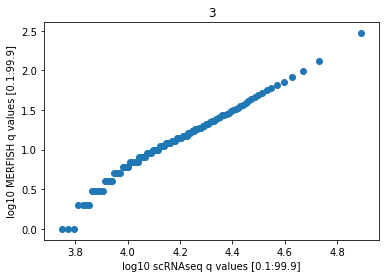

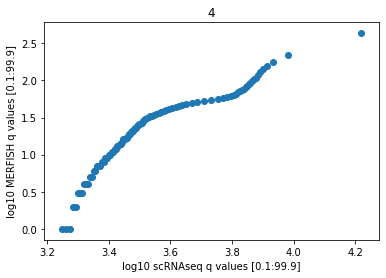

...

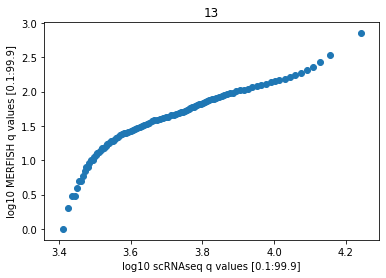

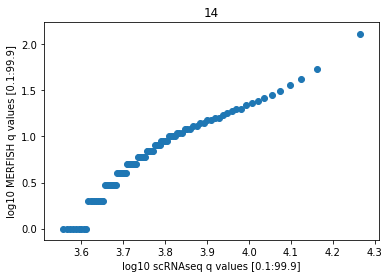

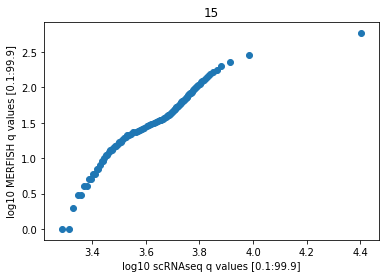

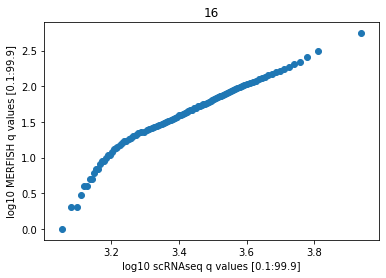

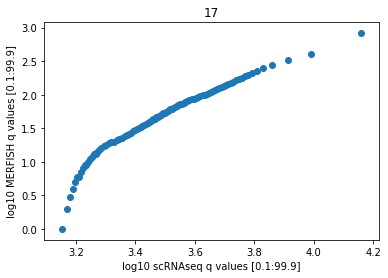

In [23]:
%matplotlib inline
qvalues = np.linspace(0.1,99.9,100)
for i in MERFISH_compressed.columns:
    scqvalues = []
    merqvalues = []
    mervalues = np.array(MERFISH_compressed[i])
    scvalues = np.array(scRNAseq_compressed[i]*(10**6))
    for q in qvalues:
        scqvalues.append(np.percentile(scvalues,q))
        merqvalues.append(np.percentile(mervalues,q))
    plt.scatter(np.log10(scqvalues),np.log10(merqvalues))
    plt.xlabel('log10 scRNAseq q values [0.1:99.9]')
    plt.ylabel('log10 MERFISH q values [0.1:99.9]')
    plt.title(i)
    plt.show()

In [ ]:
# redo with intensity to both
full_compressed_df = pd.read_csv('/bigstore/GeneralStorage/Zach/CSI/full_compressed_df.csv.gz',index_col)

In [36]:
post_adata3 = anndata.AnnData(X=compressed)
post_adata3.obsm["matrix"] = matrix
post_adata3.obsm["X_scVI"] = np.array(latent)
post_adata3.obs['cell_type'] = np.array(info_df['cell_type'])
# post_adata3.obs['imputed_cell_type'] = np.array(info_df['imputed_cell_type'])
post_adata3.obs['label'] = np.array(range(len(info_df)))
post_adata3.obs['cell'] = pd.Series(info_df.index, dtype="category")
post_adata3.obs['region'] = np.array(info_df['region'])
post_adata3.obs['dataset'] = np.array(info_df['dataset'])
post_adata3.obs['treatment'] = np.array(info_df['treatment'])
sc.pp.neighbors(post_adata3)

<IPython.core.display.Javascript object>


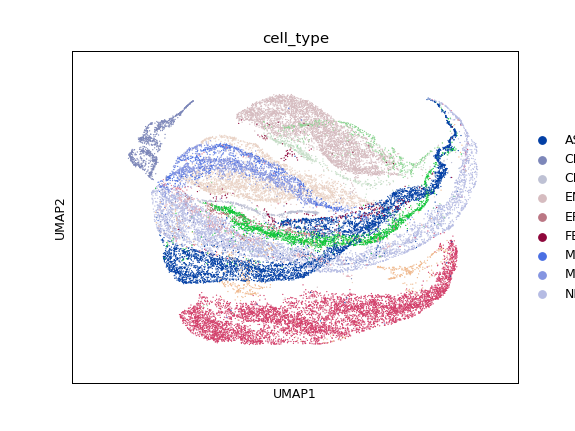

In [35]:
%matplotlib notebook
sc.tl.umap(post_adata3)
sc.pl.umap(post_adata3, color='cell_type')

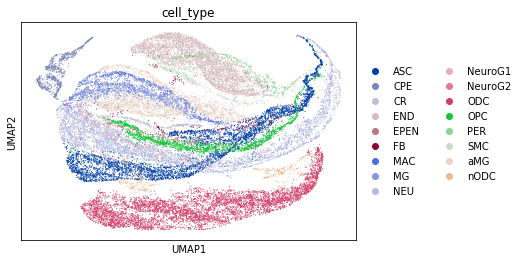

In [37]:
%matplotlib inline
sc.tl.umap(post_adata3)
sc.pl.umap(post_adata3, color='cell_type')

In [40]:
import random
from sklearn.metrics.pairwise import euclidean_distances
self = CSC
self.sample = 1
X = np.array(compressed.copy())
cells = np.array(self.cells)
n = random.sample(list(range(self.ncells)),int(self.sample*self.ncells))
dist = euclidean_distances(X, X[n,:])
rank = dist.argpartition(self.k+1,axis=0)[:self.k+1,:]
metrics = []
correlations = []
sample_cells = []
for i,idx in enumerate(n):
    sample_cells.append(cells[idx])
sample_cells_df = pd.DataFrame([i.split('_')[-1] for i in sample_cells],
                               index=sample_cells,columns=['cell_type'])
cell_types = list(info_df.cell_type.unique())
cell_types.sort()
cell_types_idx = pd.DataFrame(range(len(cell_types)),index=cell_types)
cell_type_matrix = np.zeros_like(rank)
for x in range(rank.shape[0]):
    for y in range(rank.shape[1]):
        cell_type_matrix[x,y] = cell_types_idx.loc[cells[rank[x,y]].split('_')[-1]].iloc[0]
from scipy.stats import mode
real = cell_type_matrix[0,:]
imputed = mode(cell_type_matrix[1:,:],axis=0).mode.T[:,0]
temp = pd.DataFrame(cell_types_idx.index,index=cell_types_idx[0])
imputed_cell_types = pd.DataFrame([temp.loc[i].iloc[0] for i in imputed],
                                  index=sample_cells,columns=['imputed'])
info_df['imputed_cell_type'] = imputed_cell_types
cell_type_dict = {}
for idx in cell_types_idx[0]:
    cell_type_dict[idx] = []
for i,r in enumerate(real):
    cell_type_dict[r].append(imputed[i])
confusion_matrix = np.zeros((len(cell_types),len(cell_types)))
for key,imlist in cell_type_dict.items():
    for cell_type,n in Counter(imlist).items():
        confusion_matrix[key,cell_type]= n/len(imlist)

NameError: name 'Counter' is not defined

In [41]:
from collections import defaultdict, Counter
confusion_matrix = np.zeros((len(cell_types),len(cell_types)))
for key,imlist in cell_type_dict.items():
    for cell_type,n in Counter(imlist).items():
        confusion_matrix[key,cell_type]= n/len(imlist)

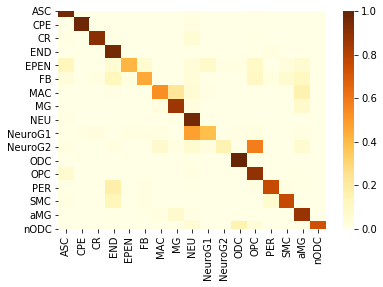

In [42]:
%matplotlib inline
import seaborn as sns
sns.heatmap(pd.DataFrame(confusion_matrix,index=cell_types_idx.index,
                         columns = cell_types_idx.index),cmap='YlOrBr',vmin=0,vmax=1)
plt.show()

... storing 'imputed_cell_type' as categorical


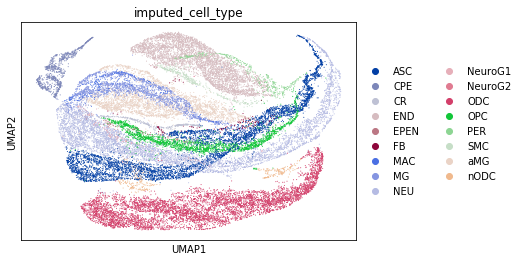

In [44]:
post_adata3.obs['imputed_cell_type'] = info_df['imputed_cell_type']
sc.pl.umap(post_adata3, color='imputed_cell_type')

In [45]:
Counter(info_df.cell_type)

Counter({'ODC': 5808,
         'ASC': 4599,
         'NEU': 4270,
         'aMG': 2641,
         'END': 3914,
         'MG': 1801,
         'OPC': 2018,
         'CPE': 910,
         'PER': 441,
         'SMC': 416,
         'nODC': 531,
         'CR': 366,
         'NeuroG1': 277,
         'MAC': 513,
         'FB': 221,
         'NeuroG2': 158,
         'EPEN': 129})

In [ ]:
#Generate synthetic data


In [46]:
bad = []
for i,value in enumerate(info_df.cell_type):
    if value !=info_df.imputed_cell_type.iloc[i]:
        bad.append(i)

In [48]:
len(bad)/len(info_df)

0.07282942129390273

In [49]:
full_compressed_df = pickle.load(open('/bigstore/GeneralStorage/Zach/CSI/full_compressed_df.pkl','rb'))

/home/zach/miniconda3/envs/pytorch/lib/python3.6/site-packages/numba/typed_passes.py:271: NumbaPerformanceWarning: 
The keyword argument 'parallel=True' was specified but no transformation for parallel execution was possible.

To find out why, try turning on parallel diagnostics, see http://numba.pydata.org/numba-doc/latest/user/parallel.html#diagnostics for help.

File "../../../miniconda3/envs/pytorch/lib/python3.6/site-packages/umap/rp_tree.py", line 135:
@numba.njit(fastmath=True, nogil=True, parallel=True)
def euclidean_random_projection_split(data, indices, rng_state):
^

  state.func_ir.loc))
/home/zach/miniconda3/envs/pytorch/lib/python3.6/site-packages/umap/nndescent.py:92: NumbaPerformanceWarning: 
The keyword argument 'parallel=True' was specified but no transformation for parallel execution was possible.

To find out why, try turning on parallel diagnostics, see http://numba.pydata.org/numba-doc/latest/user/parallel.html#diagnostics for help.

File "../../../miniconda3/envs

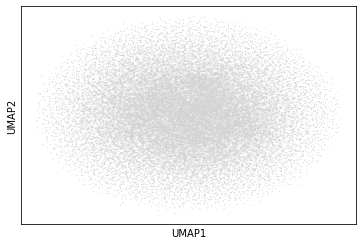

In [50]:
post_adata4 = anndata.AnnData(X=np.array(full_compressed_df))
sc.pp.neighbors(post_adata4)
sc.tl.umap(post_adata4)
sc.pl.umap(post_adata4)

In [51]:
MERFISH_pixels = pd.read_csv('/bigstore/GeneralStorage/Zach/CSI/Hippocampus_sham_m3_segmented_data/Merged.Cells.pixel.Coords.csv.gz')
MERFISH_stage = pd.read_csv('/bigstore/GeneralStorage/Zach/CSI/Hippocampus_sham_m3_segmented_data/Merged.Cells.stage.Coords.csv.gz')


In [ ]:
MERFISH[i for i in MERFISH]

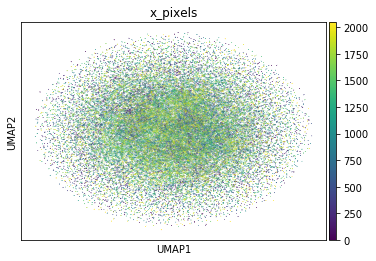

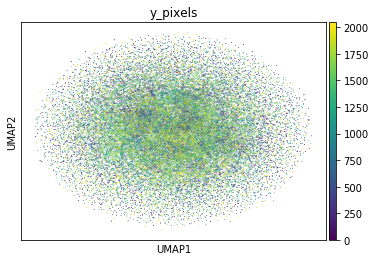

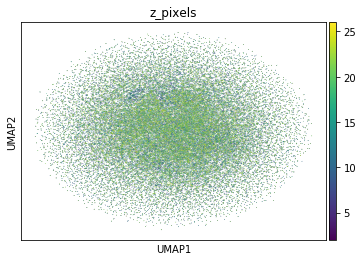

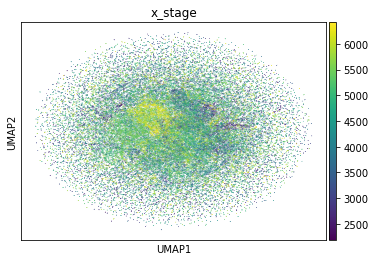

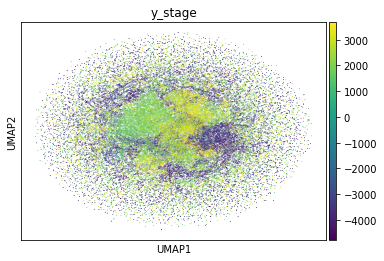

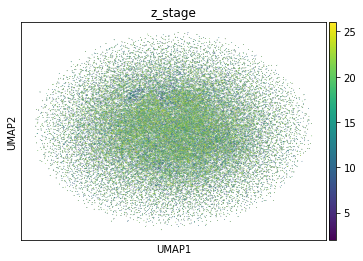

In [52]:
%matplotlib inline
post_adata4.obs['x_pixels'] = np.array(MERFISH_pixels.x)
post_adata4.obs['y_pixels'] = np.array(MERFISH_pixels.y)
post_adata4.obs['z_pixels'] = np.array(MERFISH_pixels.z)
post_adata4.obs['x_stage'] = np.array(MERFISH_stage.x)
post_adata4.obs['y_stage'] = np.array(MERFISH_stage.y)
post_adata4.obs['z_stage'] = np.array(MERFISH_stage.z)
sc.pl.umap(post_adata4, color='x_pixels')
sc.pl.umap(post_adata4, color='y_pixels')
sc.pl.umap(post_adata4, color='z_pixels')
sc.pl.umap(post_adata4, color='x_stage')
sc.pl.umap(post_adata4, color='y_stage')
sc.pl.umap(post_adata4, color='z_stage')

In [28]:
cell_counts_df

,A730060N03Rik,A830036E02Rik,Abcb1a,Adamts9,Aqp4,Arap2,Arhgap45,Asb7,Atf6,Bbs1,...,blank16,blank17,blank2,blank3,blank4,blank5,blank6,blank7,blank8,blank9
0,0,0,0,1,0,1,0,0,0,0,...,0,2,0,0,1,0,0,0,0,0
1,0,1,0,0,1,0,0,0,0,1,...,0,1,0,0,0,0,0,0,0,0
2,0,1,0,1,0,2,0,0,6,10,...,0,2,0,0,3,0,0,0,0,4
3,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
4,0,0,0,1,1,1,1,0,6,1,...,0,3,0,0,3,0,0,0,1,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
29646,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
29647,0,0,0,1,0,1,0,0,1,0,...,0,0,0,0,0,1,0,0,0,1
29648,0,0,0,0,0,0,3,1,0,0,...,0,0,0,1,0,0,0,0,0,1
29649,0,0,0,0,0,0,0,0,0,0,...,0,0,0,1,0,0,0,0,1,1


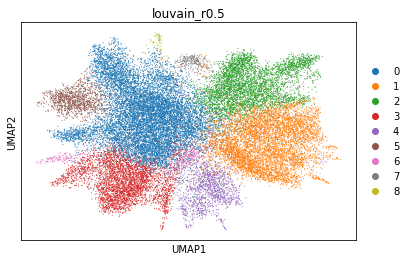

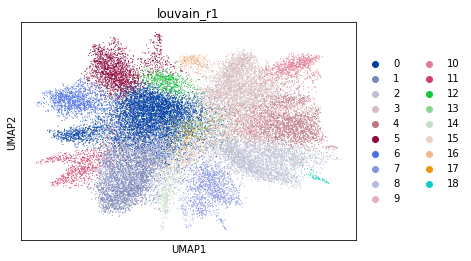

In [30]:
%matplotlib inline
cell_counts_df =  pd.read_csv('/bigstore/GeneralStorage/Zach/CSI/cell_counts_df.csv.gz',index_col=0)
post_adata5 = anndata.AnnData(X=np.array((cell_counts_df-np.median(cell_counts_df,axis=0))/np.std(cell_counts_df,axis=0)))
sc.pp.neighbors(post_adata5,use_rep='X')
sc.tl.louvain(post_adata5, resolution=0.5, key_added='louvain_r0.5', random_state=10)
sc.tl.louvain(post_adata5, resolution=1, key_added='louvain_r1', random_state=10)
sc.tl.umap(post_adata5)
sc.pl.umap(post_adata5,color='louvain_r0.5')
sc.pl.umap(post_adata5,color='louvain_r1')


/home/zach/miniconda3/envs/pytorch/lib/python3.6/site-packages/numba/typed_passes.py:271: NumbaPerformanceWarning: 
The keyword argument 'parallel=True' was specified but no transformation for parallel execution was possible.

To find out why, try turning on parallel diagnostics, see http://numba.pydata.org/numba-doc/latest/user/parallel.html#diagnostics for help.

File "../../../miniconda3/envs/pytorch/lib/python3.6/site-packages/umap/nndescent.py", line 47:
    @numba.njit(parallel=True)
    def nn_descent(
    ^

  state.func_ir.loc))


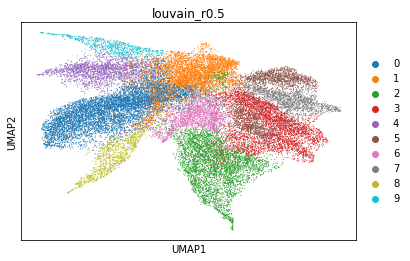

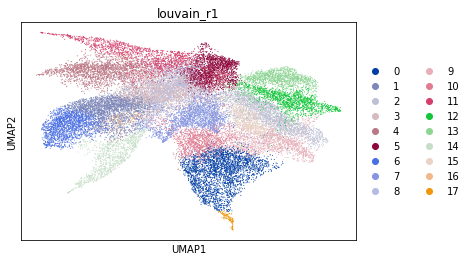

In [32]:
%matplotlib inline
cell_counts_df =  pd.read_csv('/bigstore/GeneralStorage/Zach/CSI/cell_counts_df.csv.gz',index_col=0)
post_adata6 = anndata.AnnData(X=np.array(cell_counts_df))
sc.pp.neighbors(post_adata6,use_rep='X')
sc.tl.louvain(post_adata6, resolution=0.5, key_added='louvain_r0.5', random_state=10)
sc.tl.louvain(post_adata6, resolution=1, key_added='louvain_r1', random_state=10)
sc.tl.umap(post_adata6)
sc.pl.umap(post_adata6,color='louvain_r0.5')
sc.pl.umap(post_adata6,color='louvain_r1')

         Falling back to preprocessing with `sc.pp.pca` and default params.


/home/zach/miniconda3/envs/pytorch/lib/python3.6/site-packages/numba/typed_passes.py:271: NumbaPerformanceWarning: 
The keyword argument 'parallel=True' was specified but no transformation for parallel execution was possible.

To find out why, try turning on parallel diagnostics, see http://numba.pydata.org/numba-doc/latest/user/parallel.html#diagnostics for help.

File "../../../miniconda3/envs/pytorch/lib/python3.6/site-packages/umap/nndescent.py", line 47:
    @numba.njit(parallel=True)
    def nn_descent(
    ^

  state.func_ir.loc))


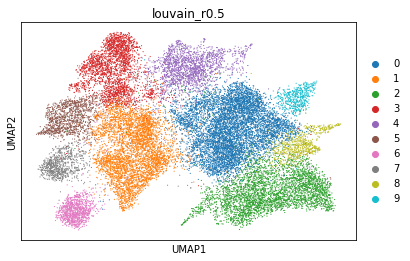

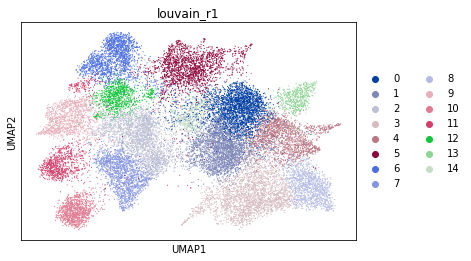

In [112]:
%matplotlib inline
cell_counts_df =  pd.read_csv('/bigstore/GeneralStorage/Zach/CSI/cell_counts_df.csv.gz',index_col=0)
cell_info_df =  pd.read_csv('/bigstore/GeneralStorage/Zach/CSI/cell_info_df.csv.gz',index_col=0)
border_xy = 100
border_z = 5
keepers = cell_info_df[(cell_info_df.z>0+border_z)&
                       (cell_info_df.z<cell_info_df.z.max()-border_z)&
                       (cell_info_df.pixel_x>0+border_xy)&
                       (cell_info_df.pixel_x<2048-border_xy)&
                       (cell_info_df.pixel_y>0+border_xy)&
                       (cell_info_df.pixel_y<2048-border_xy)].index
genes = [i for i in cell_counts_df.columns if not 'blank' in i]
temp_df = cell_counts_df[genes].loc[keepers]
normalized_cell_counts_df = np.divide(temp_df,np.sum(temp_df,axis=1)[:,None])
Zscore = (normalized_cell_counts_df-np.median(normalized_cell_counts_df,axis=0))/np.std(normalized_cell_counts_df,axis=0)
post_adata7 = anndata.AnnData(X=np.array(Zscore))
sc.pp.neighbors(post_adata7)
sc.tl.louvain(post_adata7, resolution=0.5, key_added='louvain_r0.5', random_state=10)
sc.tl.louvain(post_adata7, resolution=1, key_added='louvain_r1', random_state=10)
sc.tl.umap(post_adata7)
sc.pl.umap(post_adata7,color='louvain_r0.5')
sc.pl.umap(post_adata7,color='louvain_r1')


/home/zach/miniconda3/envs/pytorch/lib/python3.6/site-packages/numba/typed_passes.py:271: NumbaPerformanceWarning: 
The keyword argument 'parallel=True' was specified but no transformation for parallel execution was possible.

To find out why, try turning on parallel diagnostics, see http://numba.pydata.org/numba-doc/latest/user/parallel.html#diagnostics for help.

File "../../../miniconda3/envs/pytorch/lib/python3.6/site-packages/umap/nndescent.py", line 47:
    @numba.njit(parallel=True)
    def nn_descent(
    ^

  state.func_ir.loc))


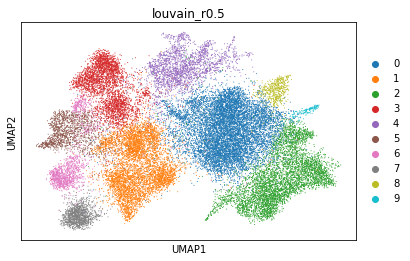

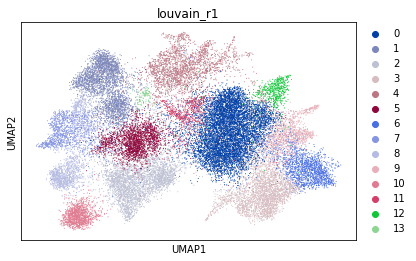

In [122]:
%matplotlib inline
cell_counts_df =  pd.read_csv('/bigstore/GeneralStorage/Zach/CSI/cell_counts_df.csv.gz',index_col=0)
genes = [i for i in cell_counts_df.columns if not 'blank' in i]
temp_df = cell_counts_df[genes]#.loc[keepers]
normalized_cell_counts_df = np.divide(temp_df,np.sum(temp_df,axis=1)[:,None])
Zscore = (normalized_cell_counts_df-np.median(normalized_cell_counts_df,axis=0))/np.std(normalized_cell_counts_df,axis=0)
post_adata6 = anndata.AnnData(X=np.array(Zscore))
sc.pp.neighbors(post_adata6,use_rep='X')
sc.tl.louvain(post_adata6, resolution=0.5, key_added='louvain_r0.5', random_state=10)
sc.tl.louvain(post_adata6, resolution=1, key_added='louvain_r1', random_state=10)
sc.tl.umap(post_adata6)
sc.pl.umap(post_adata6,color='louvain_r0.5')
sc.pl.umap(post_adata6,color='louvain_r1')


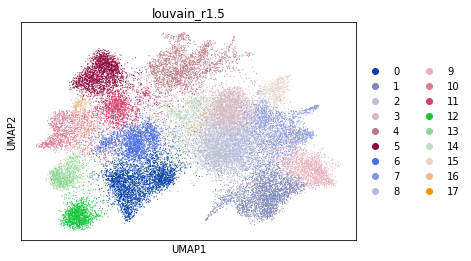

In [123]:
sc.tl.louvain(post_adata6, resolution=1.5, key_added='louvain_r1.5', random_state=10)
sc.pl.umap(post_adata6,color='louvain_r1.5')

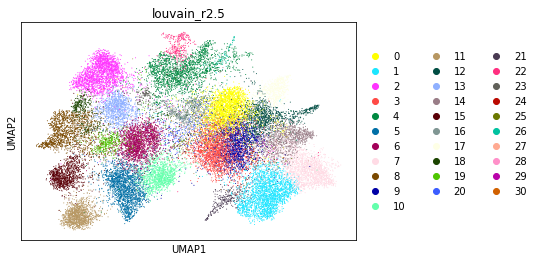

In [124]:
sc.tl.louvain(post_adata6, resolution=2.5, key_added='louvain_r2.5', random_state=10)
sc.pl.umap(post_adata6,color='louvain_r2.5')

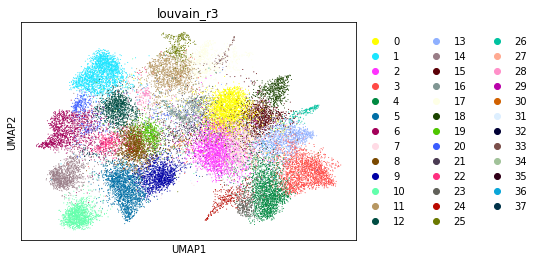

In [125]:
sc.tl.louvain(post_adata6, resolution=3, key_added='louvain_r3', random_state=10)
sc.pl.umap(post_adata6,color='louvain_r3')

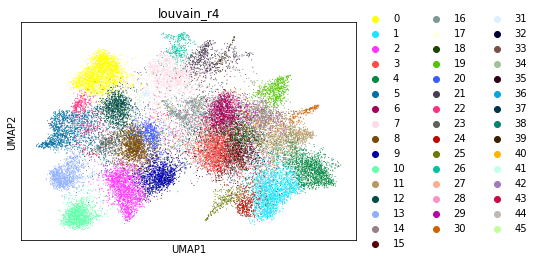

In [126]:
sc.tl.louvain(post_adata6, resolution=4, key_added='louvain_r4', random_state=10)
sc.pl.umap(post_adata6,color='louvain_r4')

In [128]:
post_adata6.obs['cell'] = np.array(cell_counts_df.index)
post_adata6.obs.to_csv('/bigstore/GeneralStorage/Zach/CSI/post_adata6.csv.gz',compression='gzip')

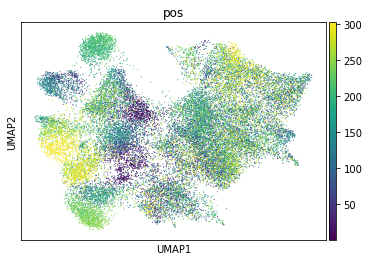

In [79]:
post_adata6.obs['pos'] = np.array([int(i.split('Pos')[-1]) for i in cell_info_df.pos])
sc.pl.umap(post_adata6,color='pos')

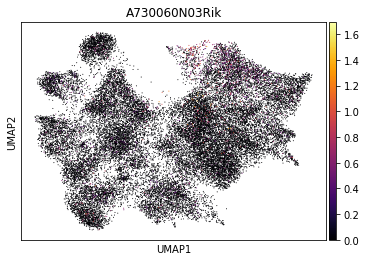

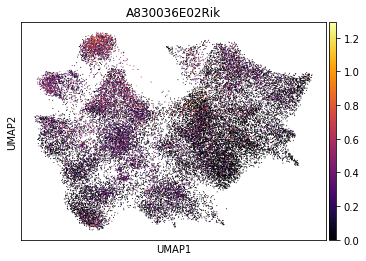

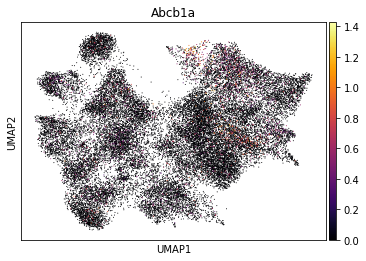

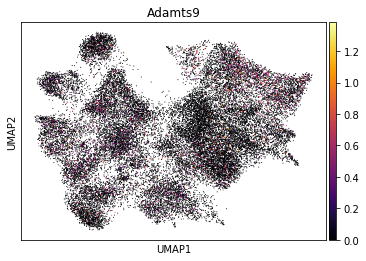

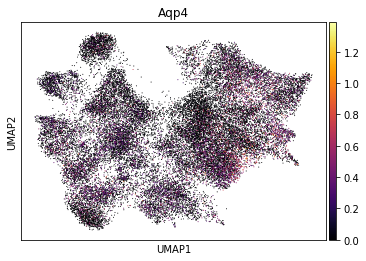

...

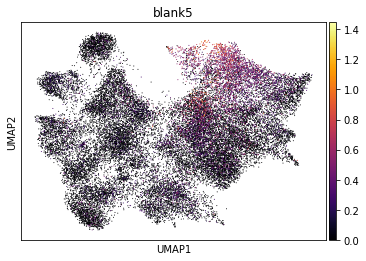

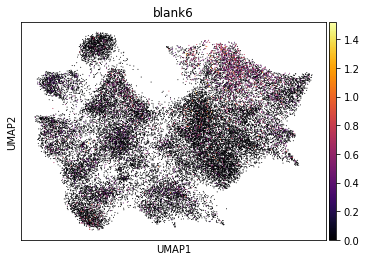

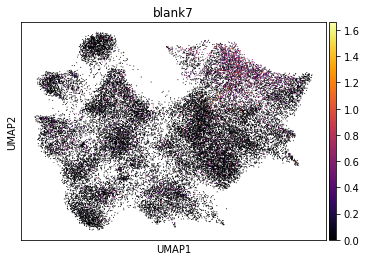

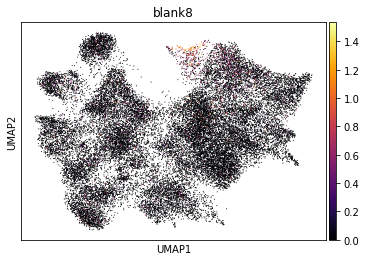

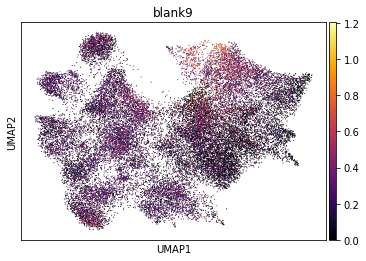

In [88]:
for gene in cell_counts_df.columns:
    if np.average(cell_counts_df[gene],axis=0)>0:
        post_adata6.obs[gene] = np.array(np.log10(np.abs(Zscore[gene])+1))
        sc.pl.umap(post_adata6,color=gene,cmap='inferno')

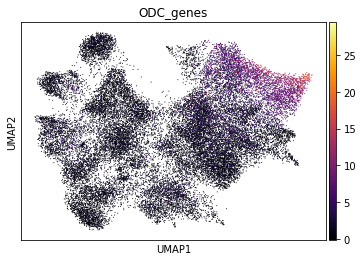

In [98]:
genes = ['Mapt', 'Mog', 'Opalin', 'Ttyh2']
title = 'ODC_genes'
post_adata6.obs[title] = np.array(np.sum(Zscore[genes],axis=1))
sc.pl.umap(post_adata6,color=title,cmap='inferno')

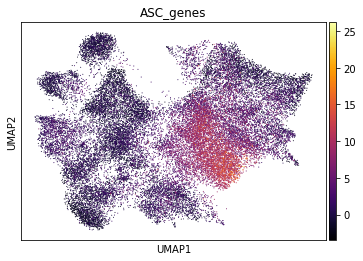

In [97]:
genes = ['Aqp4', 'Bcan', 'Cxcl14', 'Farp1', 'Gja1', 'Ncan', 'Ntrk2']
title = 'ASC_genes'
post_adata6.obs[title] = np.array(np.sum(Zscore[genes],axis=1))
sc.pl.umap(post_adata6,color=title,cmap='inferno')

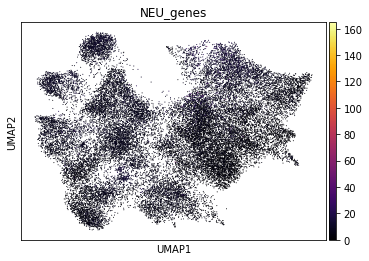

In [101]:
genes = ['A730060N03Rik', 'A830036E02Rik', 'Calb1', 'Ckmt1', 'Cnih3', 'Grm2', 'Hecw1', 'Kcnc4', 'Lypd1', 'Ntng1', 'Pcsk5', 'Rnf207', 'Tnfaip8l3']
title = 'NEU_genes'
post_adata6.obs[title] = np.array(np.sum(Zscore[genes],axis=1))
sc.pl.umap(post_adata6,color=title,cmap='inferno')

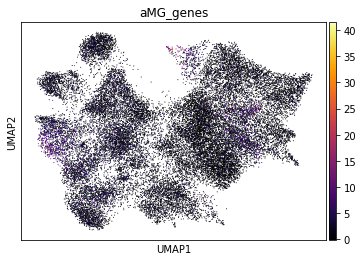

In [102]:
genes = ['Egr1', 'Pdgfb', 'Slc15a3', 'Tnf']
title = 'aMG_genes'
post_adata6.obs[title] = np.array(np.sum(Zscore[genes],axis=1))
sc.pl.umap(post_adata6,color=title,cmap='inferno')

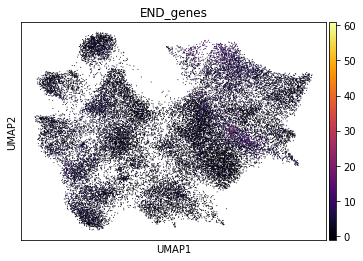

In [103]:
genes = ['Abcb1a', 'Cnot6l', 'Cxcl12', 'Flt1', 'Mfsd2a', 'Nes']
title = 'END_genes'
post_adata6.obs[title] = np.array(np.sum(Zscore[genes],axis=1))
sc.pl.umap(post_adata6,color=title,cmap='inferno')

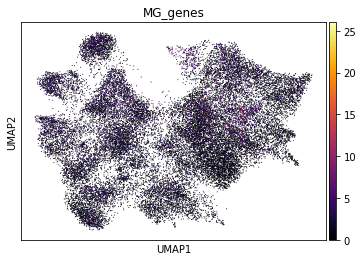

In [104]:
genes = ['Mcph1', 'Selplg', 'Trappc8']
title = 'MG_genes'
post_adata6.obs[title] = np.array(np.sum(Zscore[genes],axis=1))
sc.pl.umap(post_adata6,color=title,cmap='inferno')

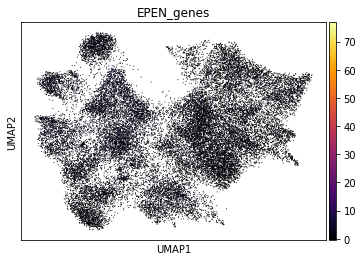

In [107]:
genes = ['Cadps2', 'Fam216b']
title = 'EPEN_genes'
post_adata6.obs[title] = np.array(np.sum(Zscore[genes],axis=1))
sc.pl.umap(post_adata6,color=title,cmap='inferno')

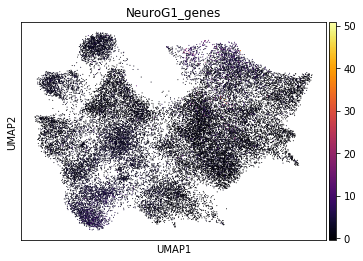

In [108]:
genes = ['Dlx6os1', 'Heph', 'Plxna4', 'Prox1']
title = 'NeuroG1_genes'
post_adata6.obs[title] = np.array(np.sum(Zscore[genes],axis=1))
sc.pl.umap(post_adata6,color=title,cmap='inferno')

In [90]:
cell_info_df['louvain_r0.5'] = list(post_adata6.obs['louvain_r0.5'])
cell_info_df.to_csv('/bigstore/GeneralStorage/Zach/CSI/cell_info_df.csv.gz',compression='gzip')
cell_info_df

,stage_x,stage_y,pos,pixel_x,pixel_y,z,louvain_r0.5
0,6394.132364,1114.336273,Pos290,1707.636364,1773.727273,13.090909,3
1,5155.304571,1811.363929,Pos187,1956.922674,425.357143,13.857143,0
2,5346.885846,3366.115231,Pos214,1778.769231,1147.846154,14.000000,5
3,4844.659750,2783.026750,Pos173,1042.750000,1605.750000,7.250000,0
4,3902.601333,1870.788133,Pos103,143.131498,970.533333,16.266667,3
...,...,...,...,...,...,...,...
29646,4583.765000,-4521.144000,Pos145,585.000000,384.000000,8.000000,4
29647,4245.549667,-3334.871667,Pos117,1353.666667,1588.333333,24.000000,0
29648,4321.123000,-4665.586923,Pos111,2047.000000,994.615385,14.000000,2
29649,3846.495000,-4453.564000,Pos78,1555.000000,1004.000000,20.000000,0


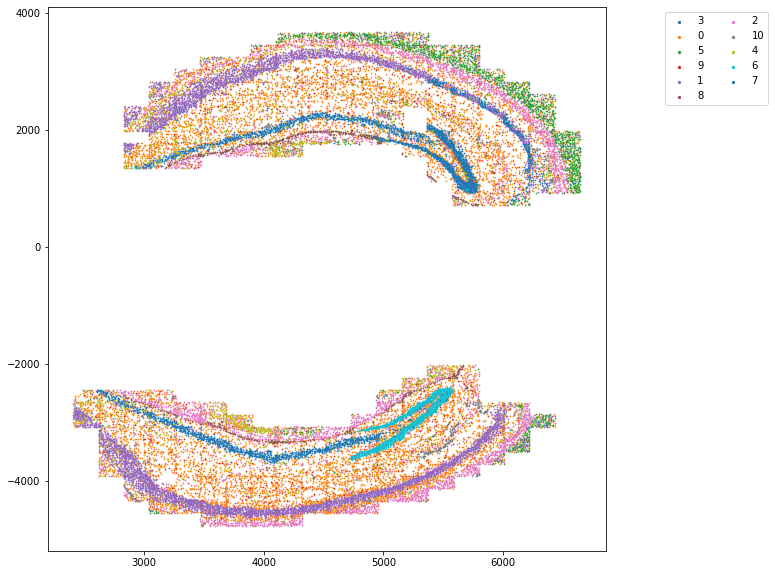

In [93]:
plt.figure(figsize=[10,10])
for ct in cell_info_df['louvain_r0.5'].unique():
    temp_df = cell_info_df[cell_info_df['louvain_r0.5']==ct]
    plt.scatter(temp_df.stage_x,temp_df.stage_y,s=0.5,label=ct)
lgnd = plt.legend(bbox_to_anchor=(0.8, 0.5, 0.5, 0.5),ncol=2)
for i in range(len(lgnd.legendHandles)):
    lgnd.legendHandles[i]._sizes = [5]
plt.show()

In [ ]:
for gene in cell_counts_df.columns:
    if np.average(cell_counts_df[gene],axis=0)>0:
        post_adata6.obs[gene] = np.array(Zscore[gene])
        sc.pl.umap(post_adata6,color=gene,cmap='inferno')

         Falling back to preprocessing with `sc.pp.pca` and default params.


/home/zach/miniconda3/envs/pytorch/lib/python3.6/site-packages/numba/typed_passes.py:271: NumbaPerformanceWarning: 
The keyword argument 'parallel=True' was specified but no transformation for parallel execution was possible.

To find out why, try turning on parallel diagnostics, see http://numba.pydata.org/numba-doc/latest/user/parallel.html#diagnostics for help.

File "../../../miniconda3/envs/pytorch/lib/python3.6/site-packages/umap/nndescent.py", line 47:
    @numba.njit(parallel=True)
    def nn_descent(
    ^

  state.func_ir.loc))


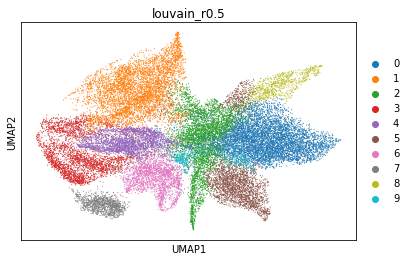

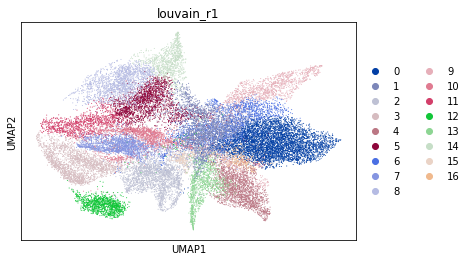

In [75]:
%matplotlib inline
# cell_counts_df =  pd.read_csv('/bigstore/GeneralStorage/Zach/CSI/cell_counts_df.csv.gz',index_col=0)
normalized_cell_counts_df = np.divide(cell_counts_df,np.sum(cell_counts_df,axis=1)[:,None])
post_adata5 = anndata.AnnData(X=np.array(normalized_cell_counts_df))
sc.pp.neighbors(post_adata5)
sc.tl.louvain(post_adata5, resolution=0.5, key_added='louvain_r0.5', random_state=10)
sc.tl.louvain(post_adata5, resolution=1, key_added='louvain_r1', random_state=10)
sc.tl.umap(post_adata5)
sc.pl.umap(post_adata5,color='louvain_r0.5')
sc.pl.umap(post_adata5,color='louvain_r1')


In [38]:
compressed_df = pd.read_csv('/bigstore/GeneralStorage/Zach/CSI/compressed_df.csv.gz',index_col=0)
cell_info_df = pd.read_csv('/bigstore/GeneralStorage/Zach/CSI/cell_info_df.csv.gz',index_col=0)
cell_counts_df = pd.read_csv('/bigstore/GeneralStorage/Zach/CSI/cell_counts_df.csv.gz',index_col=0)

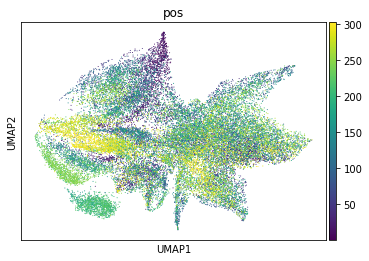

In [76]:
post_adata5.obs['pos'] = np.array([int(i.split('Pos')[-1]) for i in cell_info_df.pos])
sc.pl.umap(post_adata5,color='pos')

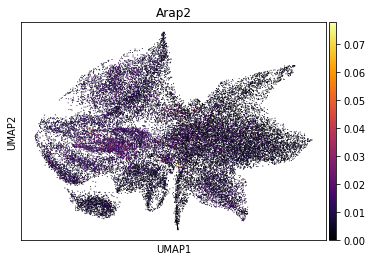

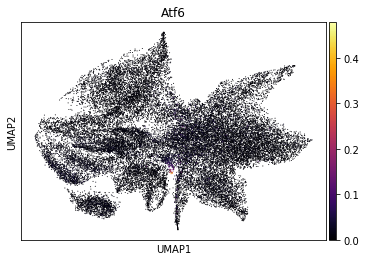

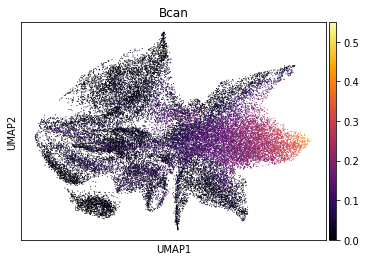

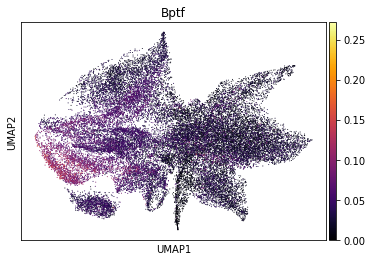

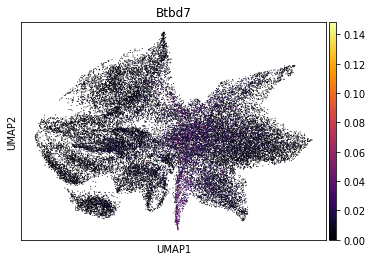

...

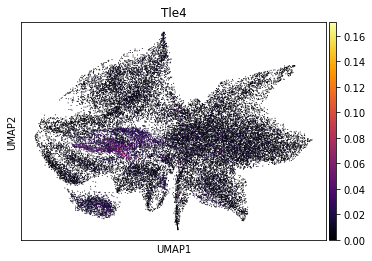

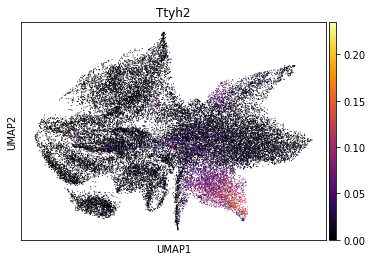

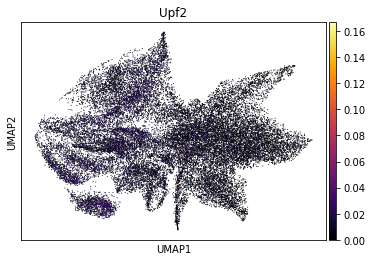

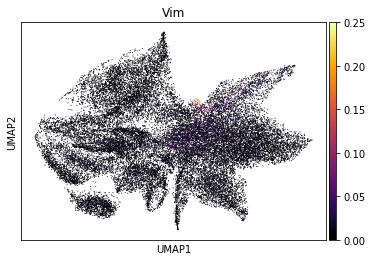

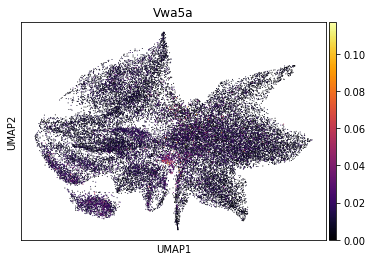

In [77]:
ss = np.sum(cell_counts_df,axis=1)
for gene in cell_counts_df.columns:
    if np.average(cell_counts_df[gene],axis=0)>1:
        post_adata5.obs[gene] = np.array(cell_counts_df[gene]/ss)
        sc.pl.umap(post_adata5,color=gene,cmap='inferno')

In [56]:
len(ss)

187

In [ ]:
cell_info_df = pd.read_csv('/bigstore/GeneralStorage/Zach/CSI/cell_info_df.csv.gz',index_col=0)
cell_info_df['']

In [141]:
linkage = np.array(pd.read_csv('/bigstore/GeneralStorage/Zach/CSI/linkage.csv',index_col=0))
linkage.shape

(29012, 4)

In [81]:
accuracy = linkage[:,2]

In [ ]:
np.random.rand(20,5)

In [142]:
latent.iloc[0:n]

,0,1,2,3,4,5,6,7,8,9
S1Hip_CCTTGCCACACT_ODC,0.392325,-0.771534,-1.173959,1.528997,0.412008,-0.678457,-0.110804,1.066432,1.334158,-0.022135
S1Hip_TTCTATTCGTAG_ODC,0.250088,-1.054843,-1.740179,1.171318,0.322338,-1.180409,0.454631,0.070974,1.275095,-0.147270
S1Hip_TTGGGCCCACCG_ODC,-0.085551,-0.430284,-0.918166,1.508396,0.936266,-0.716988,0.468579,0.686355,1.113158,-0.313047
S1Hip_ATGTACGCCGTG_ODC,0.617349,-0.243066,-1.808540,1.689078,0.312484,-0.664520,0.216020,0.383360,0.573401,0.371106
S1Hip_CCAGAATAATTT_ODC,0.390005,-0.831750,-0.980679,1.453218,1.143527,-0.850921,0.269316,0.324075,0.899953,0.021807
S1Hip_CCGCTCAAGTCC_ODC,0.375269,-1.699421,-0.867779,1.240512,0.168818,-0.099912,0.009667,0.788953,0.952461,0.099659
S1Hip_GGAGGATTGGGT_ODC,0.268406,-0.543503,-1.483808,1.342268,0.312512,-1.160080,0.112284,0.543135,1.083404,-0.003499
S1Hip_AGTCACTGTTTA_ODC,0.575224,-1.000399,-0.699959,1.388422,0.737743,-0.906542,0.564677,0.832714,0.798694,0.269874
S1Hip_TAAAACCTATCG_ODC,-0.062400,-0.246171,-0.666990,1.468270,0.947557,-0.714044,0.425894,0.929295,1.099306,0.320951
S1Hip_CCGTCCCGAGTT_ODC,0.421155,-1.035947,-1.258982,1.630589,0.418694,-1.039941,0.256036,0.750256,0.922262,0.231188


In [2]:
from matplotlib import cm
import matplotlib.pyplot as plt
import matplotlib as mpl
import scipy.cluster.hierarchy as shc

IndexError: list index out of range

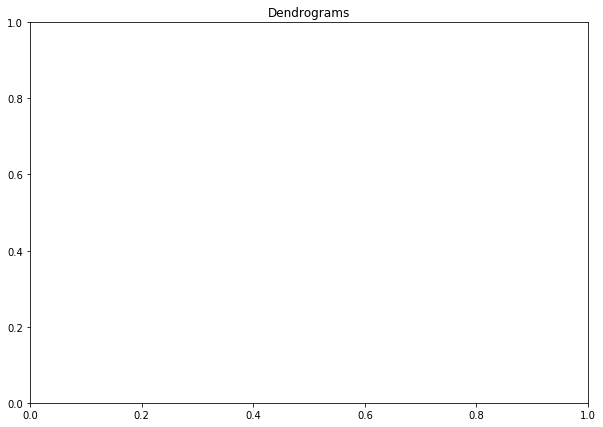

In [21]:
%matplotlib inline
n = 20
plt.figure(figsize=(10, 7))  
plt.title("Dendrograms")
linkage = shc.linkage(latent.iloc[0:n], method='ward')
# linkage[:,2] = np.log10(linkage2[:,2]+1)
accuracy = linkage[:,2]
# accuracy = accuracy-accuracy.min()
# accuracy = accuracy/accuracy.max()
cmap = cm.inferno(accuracy)
color = [mpl.colors.rgb2hex(rgb[:3]) for rgb in cmap]
colors = {}
for i,c in enumerate(color):
    colors[i+20] = c
dend2 = shc.dendrogram(Z=linkage,link_color_func=lambda x: color[x])

In [4]:
len(color)

19

In [148]:
linkage.shape

(19, 4)

In [118]:
np.min(cmap,axis=0)

array([1.4620e-03, 4.6600e-04, 1.3866e-02, 1.0000e+00])

In [119]:
np.max(cmap,axis=0)

array([0.988362, 0.998364, 0.644924, 1.      ])

In [121]:
np.median(cmap,axis=0)

array([0.817341, 0.270954, 0.408258, 1.      ])

In [116]:
mpl.colors.rgb2hex(cmap[0][:3])

'#000004'

In [94]:
cmap = cm.inferno(accuracy/accuracy.max())
[mpl.colors.rgb2hex(rgb[:3]) for rgb in cmap]

['#000004',
 '#000004',
 '#000004',
 '#000004',
 '#000004',
 '#000004',
 '#000004',
 '#000004',
 '#000004',
 '#000004',
 '#000004',
 '#000004',
 '#000004',
 '#000004',
 '#000004',
 '#000004',
 '#000004',
 '#000004',
 '#000004',
 '#000004',
 '#000004',
 '#000004',
 '#000004',
 '#000004',
 '#000004',
 '#000004',
 '#000004',
 '#000004',
 '#000004',
 '#000004',
 '#000004',
 '#000004',
 '#000004',
 '#000004',
 '#000004',
 '#000004',
 '#000004',
 '#000004',
 '#000004',
 '#000004',
 '#000004',
 '#000004',
 '#000004',
 '#000004',
 '#000004',
 '#000004',
 '#000004',
 '#000004',
 '#000004',
 '#000004',
 '#000004',
 '#000004',
 '#000004',
 '#000004',
 '#000004',
 '#000004',
 '#000004',
 '#000004',
 '#000004',
 '#000004',
 '#000004',
 '#000004',
 '#000004',
 '#000004',
 '#000004',
 '#000004',
 '#000004',
 '#000004',
 '#000004',
 '#000004',
 '#000004',
 '#000004',
 '#000004',
 '#000004',
 '#000004',
 '#000004',
 '#000004',
 '#000004',
 '#000004',
 '#000004',
 '#000004',
 '#000004',
 '#000004',
 '#0

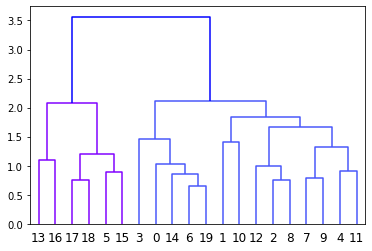

In [10]:
%matplotlib inline
from scipy.cluster import hierarchy
import matplotlib as mpl
import numpy as np
from matplotlib.pyplot import cm
cmap = cm.rainbow(np.linspace(0, 1, 10))
hierarchy.set_link_color_palette([mpl.colors.rgb2hex(rgb[:3]) for rgb in cmap])
dend2 = shc.dendrogram(linkage)


In [130]:
cm.Reds(0)

(1.0, 0.9607843137254902, 0.9411764705882353, 1.0)

In [133]:
cm.Reds(1000000)

(0.403921568627451, 0.0, 0.05098039215686274, 1.0)

In [8]:
import random
rl = ["#B061FF","61ffff"]
random.sample(rl,1)[0]

'#B061FF'

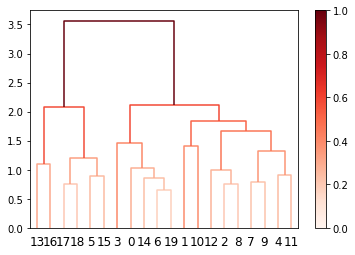

In [40]:
import random
import numpy as np
from matplotlib import cm
import matplotlib.pyplot as plt
import matplotlib as mpl
import scipy.cluster.hierarchy as shc
Z = linkage[:,0:20]
accuracy = Z[:,2]
# accuracy = accuracy-np.min(accuracy)
accuracy = accuracy/np.max(accuracy)
cmap = cm.Reds(accuracy)
temp = [mpl.colors.rgb2hex(rgb[:3]) for rgb in cmap]
link_cols = {}
for i,c in enumerate(temp):
    link_cols[i+20] = c
D = shc.dendrogram(Z=Z, link_color_func=lambda x: link_cols[x])
plt.colorbar(cm.ScalarMappable(cmap='Reds'))
plt.show()

In [3]:
clustered_MERFISH_stage = pd.read_csv('/bigstore/GeneralStorage/Zach/CSI/Hippocampus_sham_m3_segmented_data/clustered_MERFISH_stage.csv.gz',index_col=0)
clustered_MERFISH_stage

,x,y,z,Sema5a,Ttyh2,Tnfaip8l3,Cacna2d1,Ncan,Spry2,Epb41l4b,...,Myo3a,Sap30bpos,Rassf3,Prox1,Grm2,Casp8,Plekha5,Selplg,stage_x,stage_y
0,6014.663727,1107.132364,13.090909,0,0,0,3,5,2,1,...,0,0,0,0,0,0,0,0,6394.132364,1114.336273
1,5106.636071,1767.304571,13.857143,6,1,0,1,12,2,4,...,0,0,0,0,0,0,0,0,5155.304571,1811.363929
2,5027.884769,3434.885846,14.000000,13,7,1,5,18,5,3,...,0,0,0,0,0,0,0,0,5346.885846,3366.115231
3,4555.973250,2721.659750,7.250000,0,0,0,0,13,1,0,...,0,0,0,0,0,1,0,0,4844.659750,2783.026750
4,3711.211867,1850.601333,16.266667,4,2,0,1,21,1,1,...,0,0,2,0,0,0,0,0,3902.601333,1870.788133
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
14611,2800.663333,1457.668000,8.000000,0,0,0,0,8,0,0,...,0,0,0,0,0,0,0,1,2947.668000,1375.336667
14612,3453.877000,1931.552000,2.000000,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,3843.552000,1988.123000
14613,5811.976692,2191.845154,14.000000,0,20,0,1,4,1,1,...,0,0,0,0,0,0,1,0,6212.845154,2161.023308
14614,3584.692571,2451.238714,20.000000,0,0,0,0,2,0,0,...,0,0,0,0,0,0,0,2,3730.238714,2490.307429


In [5]:
non_gene_columns = ['x','y','z','stage_x','stage_y']
Merfish_scMatrix = clustered_MERFISH_stage.drop(columns=non_gene_columns)

In [13]:
post_adata4 = anndata.AnnData(X=np.array(Merfish_scMatrix))
post_adata4.obs['x'] = np.array(clustered_MERFISH_stage.stage_x)
post_adata4.obs['y'] = np.array(clustered_MERFISH_stage.stage_y)
post_adata4.obs['z'] = np.array(clustered_MERFISH_stage.z)

sc.pp.neighbors(post_adata4,use_rep='X')

/home/zach/miniconda3/envs/pytorch/lib/python3.6/site-packages/numba/typed_passes.py:271: NumbaPerformanceWarning: 
The keyword argument 'parallel=True' was specified but no transformation for parallel execution was possible.

To find out why, try turning on parallel diagnostics, see http://numba.pydata.org/numba-doc/latest/user/parallel.html#diagnostics for help.

File "../../../miniconda3/envs/pytorch/lib/python3.6/site-packages/umap/rp_tree.py", line 135:
@numba.njit(fastmath=True, nogil=True, parallel=True)
def euclidean_random_projection_split(data, indices, rng_state):
^

  state.func_ir.loc))
/home/zach/miniconda3/envs/pytorch/lib/python3.6/site-packages/numba/typed_passes.py:271: NumbaPerformanceWarning: 
The keyword argument 'parallel=True' was specified but no transformation for parallel execution was possible.

To find out why, try turning on parallel diagnostics, see http://numba.pydata.org/numba-doc/latest/user/parallel.html#diagnostics for help.

File "../../../miniconda3

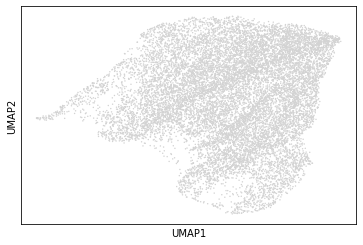

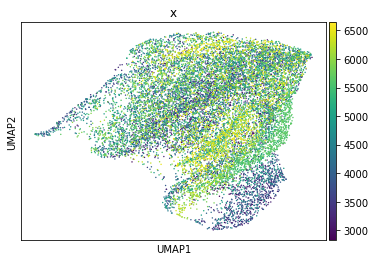

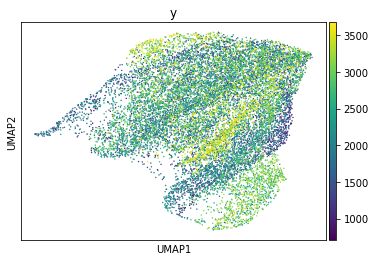

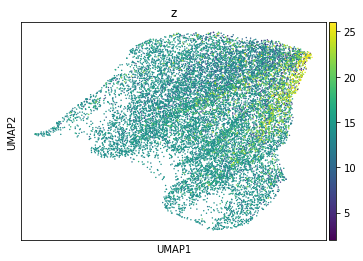

In [14]:
%matplotlib inline 
sc.tl.umap(post_adata4)
sc.pl.umap(post_adata4)
sc.pl.umap(post_adata4,color='x')
sc.pl.umap(post_adata4,color='y')
sc.pl.umap(post_adata4,color='z')


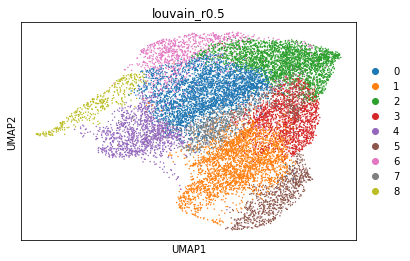

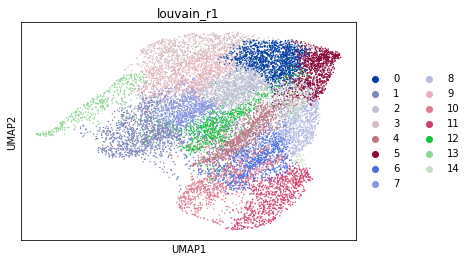

In [15]:
sc.tl.louvain(post_adata4, resolution=0.5, key_added='louvain_r0.5', random_state=10)
sc.tl.louvain(post_adata4, resolution=1, key_added='louvain_r1', random_state=10)
sc.pl.umap(post_adata4,color='louvain_r0.5')
sc.pl.umap(post_adata4,color='louvain_r1')

In [18]:
clustered_MERFISH_stage['louvain_r0.5'] = list(post_adata4.obs['louvain_r0.5'])
clustered_MERFISH_stage

,x,y,z,Sema5a,Ttyh2,Tnfaip8l3,Cacna2d1,Ncan,Spry2,Epb41l4b,...,Sap30bpos,Rassf3,Prox1,Grm2,Casp8,Plekha5,Selplg,stage_x,stage_y,louvain_r0.5
0,6014.663727,1107.132364,13.090909,0,0,0,3,5,2,1,...,0,0,0,0,0,0,0,6394.132364,1114.336273,1
1,5106.636071,1767.304571,13.857143,6,1,0,1,12,2,4,...,0,0,0,0,0,0,0,5155.304571,1811.363929,0
2,5027.884769,3434.885846,14.000000,13,7,1,5,18,5,3,...,0,0,0,0,0,0,0,5346.885846,3366.115231,1
3,4555.973250,2721.659750,7.250000,0,0,0,0,13,1,0,...,0,0,0,0,1,0,0,4844.659750,2783.026750,0
4,3711.211867,1850.601333,16.266667,4,2,0,1,21,1,1,...,0,2,0,0,0,0,0,3902.601333,1870.788133,4
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
14611,2800.663333,1457.668000,8.000000,0,0,0,0,8,0,0,...,0,0,0,0,0,0,1,2947.668000,1375.336667,0
14612,3453.877000,1931.552000,2.000000,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,3843.552000,1988.123000,2
14613,5811.976692,2191.845154,14.000000,0,20,0,1,4,1,1,...,0,0,0,0,0,1,0,6212.845154,2161.023308,6
14614,3584.692571,2451.238714,20.000000,0,0,0,0,2,0,0,...,0,0,0,0,0,0,2,3730.238714,2490.307429,2


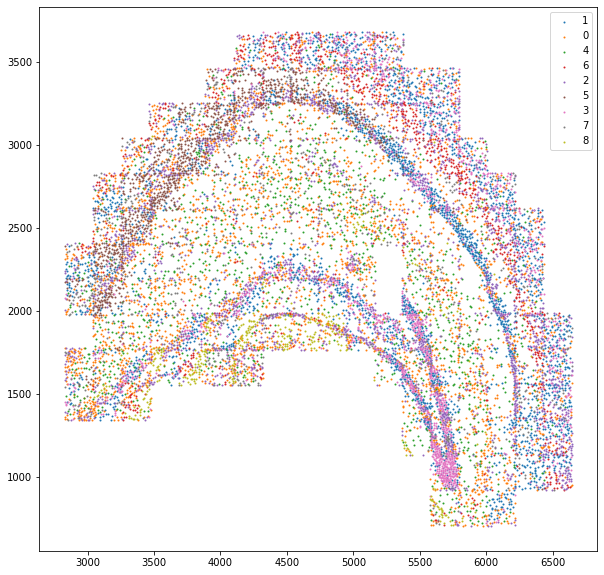

In [26]:
plt.figure(figsize=[10,10])
for CT in clustered_MERFISH_stage['louvain_r0.5'].unique():
    temp = clustered_MERFISH_stage[clustered_MERFISH_stage['louvain_r0.5']==CT]
    plt.scatter(temp.stage_x,temp.stage_y,s=1,label=CT)
plt.legend()
plt.show()

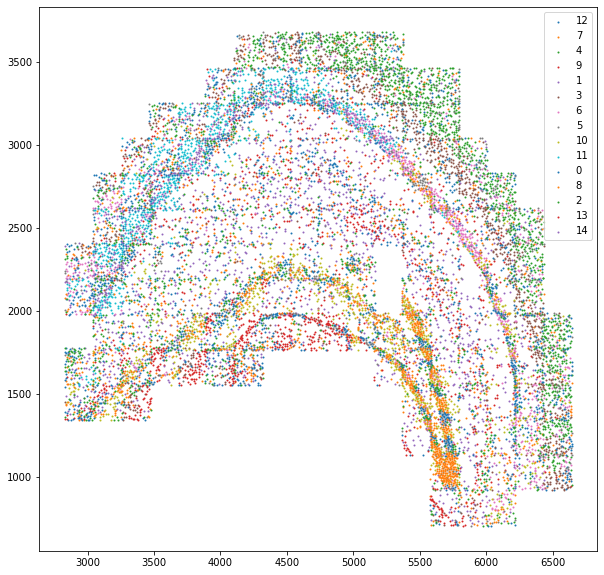

In [25]:
clustered_MERFISH_stage['louvain_r1'] = list(post_adata4.obs['louvain_r1'])
plt.figure(figsize=[10,10])
for CT in clustered_MERFISH_stage['louvain_r1'].unique():
    temp = clustered_MERFISH_stage[clustered_MERFISH_stage['louvain_r1']==CT]
    plt.scatter(temp.stage_x,temp.stage_y,s=1,label=CT)
plt.legend()
plt.show()

In [28]:
cell_type_matrix = pd.DataFrame(index=Merfish_scMatrix.columns)
for CT in clustered_MERFISH_stage['louvain_r1'].unique():
    values = []
    temp = clustered_MERFISH_stage[clustered_MERFISH_stage['louvain_r1']==CT]
    for gene in Merfish_scMatrix.columns:
        values.append(np.average(temp[gene]))
    cell_type_matrix[CT] = values
cell_type_matrix

,12,7,4,9,1,3,6,5,10,11,0,8,2,13,14
Sema5a,2.335294,0.933400,2.068662,0.433514,1.460578,0.878472,1.323762,0.295678,8.688690,0.962156,0.222299,3.719352,0.397943,1.380102,0.246684
Ttyh2,1.651765,1.715706,2.147007,1.088649,2.845433,12.433160,1.175248,0.267191,1.585666,1.917431,0.395733,0.412361,0.731013,4.586735,0.461538
Tnfaip8l3,0.991765,0.248509,0.816021,0.218378,0.582358,0.252604,0.940594,0.090373,2.665174,2.112385,0.090158,0.447822,0.174051,0.232143,0.437666
Cacna2d1,2.068235,0.877734,4.357394,0.387027,1.986729,0.673611,5.016832,0.331041,14.190370,8.396789,0.190640,2.298886,0.397152,1.265306,1.339523
Ncan,8.577647,8.427435,19.109155,9.277838,20.791569,4.318576,10.549505,1.371316,19.296753,19.324541,2.302822,4.569402,4.890823,5.971939,5.517241
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
Prox1,0.061176,0.152087,0.125000,0.121081,0.123341,0.718750,0.069307,0.053045,0.076148,0.072248,0.121129,0.051672,0.097310,0.477041,0.177719
Grm2,0.071765,0.054672,0.087148,0.057297,0.082748,0.295139,0.057426,0.013752,0.083987,0.091743,0.041294,0.032421,0.034810,0.163265,0.053050
Casp8,0.123529,0.138171,0.169894,0.107027,0.160031,0.429688,0.135644,0.026523,0.221725,0.162844,0.073641,0.062817,0.078323,0.405612,0.299735
Plekha5,0.024706,0.025845,0.081866,0.011892,0.026542,0.049479,0.056436,0.007859,0.082867,0.087156,0.012388,0.036474,0.017405,0.048469,0.023873


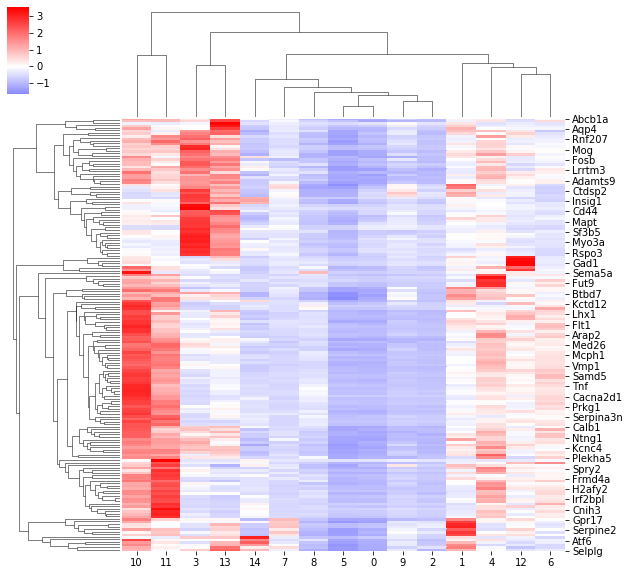

In [34]:
import seaborn as sns
sns.clustermap(cell_type_matrix,z_score=0,cmap='bwr',center=0)
plt.show()

In [38]:
1

1

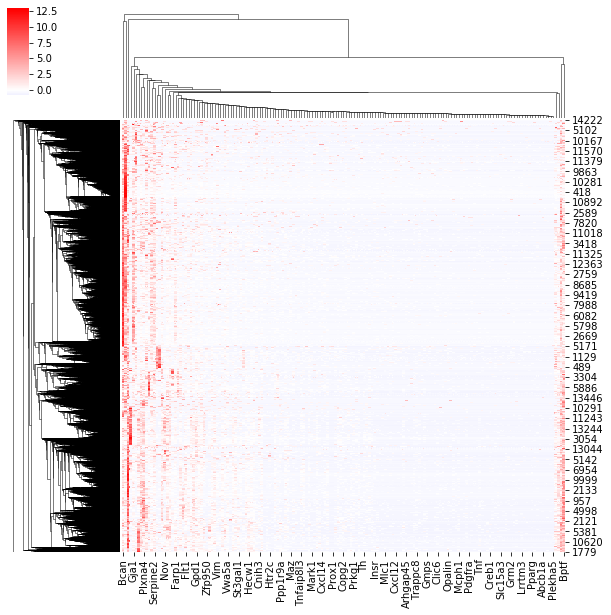

In [35]:
import seaborn as sns
sns.clustermap(Merfish_scMatrix,z_score=0,cmap='bwr',center=0)
plt.show()

In [27]:
Merfish_scMatrix

,Sema5a,Ttyh2,Tnfaip8l3,Cacna2d1,Ncan,Spry2,Epb41l4b,Fibcd1,Dyrk1a,Arap2,...,Kl,Nes,Myo3a,Sap30bpos,Rassf3,Prox1,Grm2,Casp8,Plekha5,Selplg
0,0,0,0,3,5,2,1,1,17,2,...,2,0,0,0,0,0,0,0,0,0
1,6,1,0,1,12,2,4,0,6,2,...,1,1,0,0,0,0,0,0,0,0
2,13,7,1,5,18,5,3,1,13,5,...,1,0,0,0,0,0,0,0,0,0
3,0,0,0,0,13,1,0,0,3,0,...,0,0,0,0,0,0,0,1,0,0
4,4,2,0,1,21,1,1,0,2,0,...,1,1,0,0,2,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
14611,0,0,0,0,8,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,1
14612,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
14613,0,20,0,1,4,1,1,0,1,1,...,0,0,0,0,0,0,0,0,1,0
14614,0,0,0,0,2,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,2


In [23]:
clustered_MERFISH_stage.to_csv('/bigstore/GeneralStorage/Zach/CSI/Hippocampus_sham_m3_segmented_data/clustered_MERFISH_stage.csv.gz',compression='gzip')

In [39]:
MERFISH_clustered = pd.read_csv('/bigstore/GeneralStorage/Zach/CSI/Hippocampus_sham_m3_segmented_data/MERFISH_clustered.csv.gz',index_col=0)

In [40]:
non_gene_columns = ['x','y','z','stage_x','stage_y']
Merfish_scMatrix = MERFISH_clustered.drop(columns=non_gene_columns)

/home/zach/miniconda3/envs/pytorch/lib/python3.6/site-packages/numba/typed_passes.py:271: NumbaPerformanceWarning: 
The keyword argument 'parallel=True' was specified but no transformation for parallel execution was possible.

To find out why, try turning on parallel diagnostics, see http://numba.pydata.org/numba-doc/latest/user/parallel.html#diagnostics for help.

File "../../../miniconda3/envs/pytorch/lib/python3.6/site-packages/umap/nndescent.py", line 47:
    @numba.njit(parallel=True)
    def nn_descent(
    ^

  state.func_ir.loc))


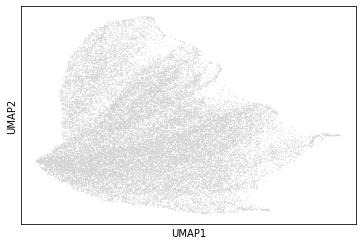

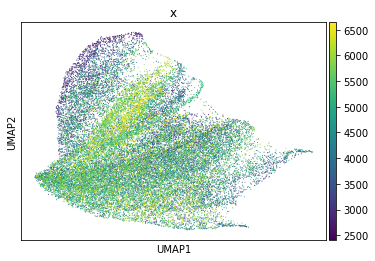

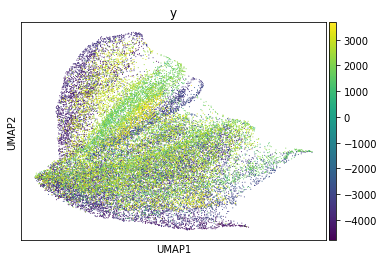

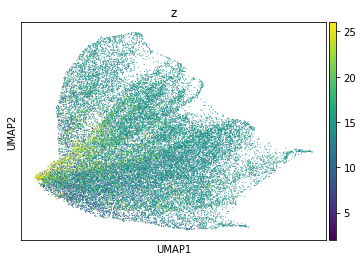

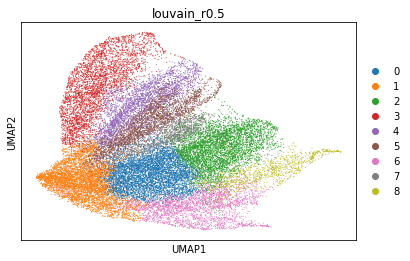

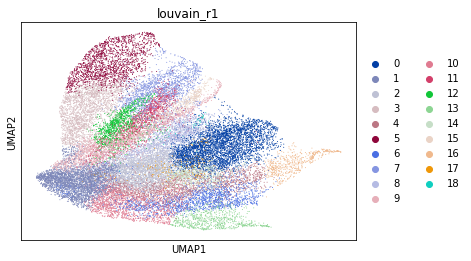

In [41]:
post_adata5 = anndata.AnnData(X=np.array(Merfish_scMatrix))
post_adata5.obs['x'] = np.array(MERFISH_clustered.stage_x)
post_adata5.obs['y'] = np.array(MERFISH_clustered.stage_y)
post_adata5.obs['z'] = np.array(MERFISH_clustered.z)

sc.pp.neighbors(post_adata5,use_rep='X')
sc.tl.louvain(post_adata5, resolution=0.5, key_added='louvain_r0.5', random_state=10)
sc.tl.louvain(post_adata5, resolution=1, key_added='louvain_r1', random_state=10)
%matplotlib inline 
sc.tl.umap(post_adata5)
sc.pl.umap(post_adata5)
sc.pl.umap(post_adata5,color='x')
sc.pl.umap(post_adata5,color='y')
sc.pl.umap(post_adata5,color='z')
sc.pl.umap(post_adata5,color='louvain_r0.5')
sc.pl.umap(post_adata5,color='louvain_r1')

         Falling back to preprocessing with `sc.pp.pca` and default params.


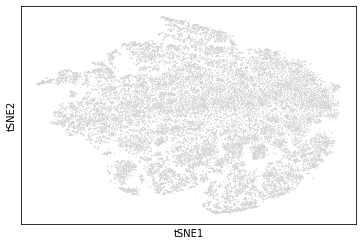

In [48]:
%matplotlib inline 
sc.tl.tsne(post_adata5,)
sc.pl.tsne(post_adata5)

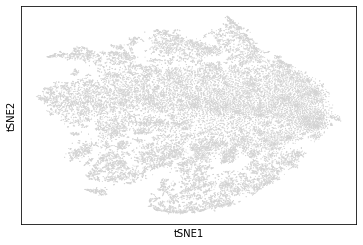

In [49]:
%matplotlib inline 
sc.tl.tsne(post_adata5,use_rep='X')
sc.pl.tsne(post_adata5)

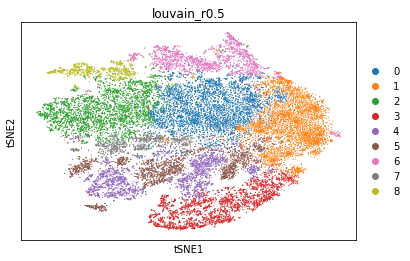

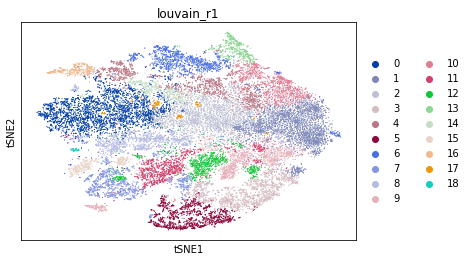

In [51]:
%matplotlib inline 
sc.pl.tsne(post_adata5,color='louvain_r0.5')
sc.pl.tsne(post_adata5,color='louvain_r1')

In [ ]:
%matplotlib inline 
sc.pl.umap(post_adata5)
sc.pl.umap(post_adata5,color='x')
sc.pl.umap(post_adata5,color='y')
sc.pl.umap(post_adata5,color='z')
sc.pl.umap(post_adata5,color='louvain_r0.5')
sc.pl.umap(post_adata5,color='louvain_r1')

In [42]:
MERFISH_clustered['louvain_r0.5'] = list(post_adata5.obs['louvain_r0.5'])
MERFISH_clustered['louvain_r1'] = list(post_adata5.obs['louvain_r1'])

MERFISH_clustered.to_csv('/bigstore/GeneralStorage/Zach/CSI/Hippocampus_sham_m3_segmented_data/MERFISH_clustered.csv.gz',compression='gzip')

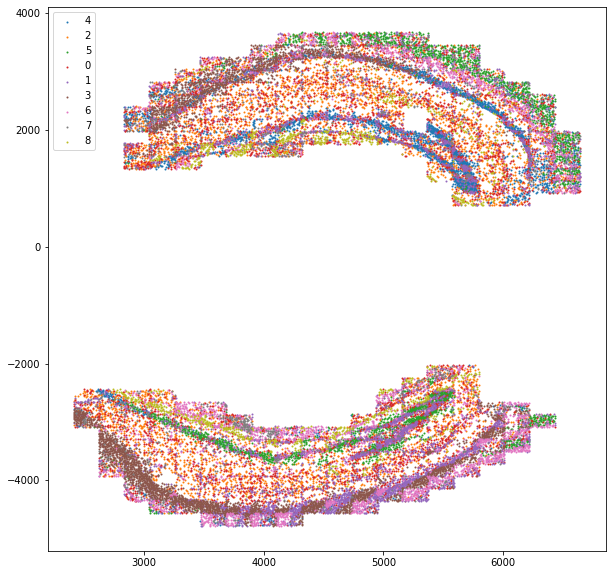

In [43]:
plt.figure(figsize=[10,10])
for CT in MERFISH_clustered['louvain_r0.5'].unique():
    temp = MERFISH_clustered[MERFISH_clustered['louvain_r0.5']==CT]
    plt.scatter(temp.stage_x,temp.stage_y,s=1,label=CT)
plt.legend()
plt.show()

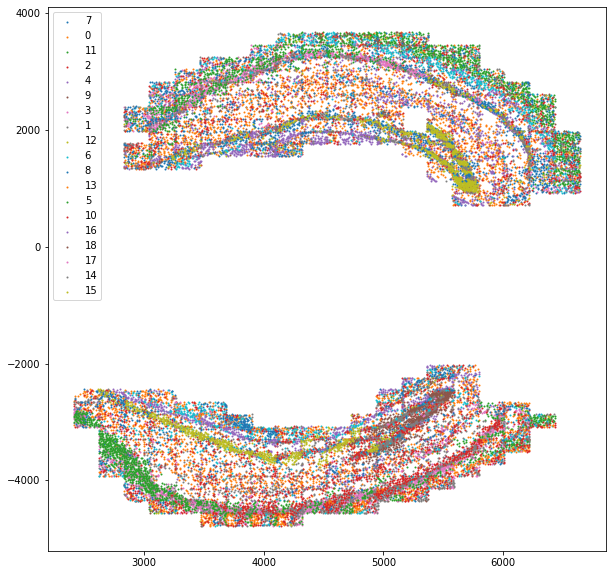

In [44]:
plt.figure(figsize=[10,10])
for CT in MERFISH_clustered['louvain_r1'].unique():
    temp = MERFISH_clustered[MERFISH_clustered['louvain_r1']==CT]
    plt.scatter(temp.stage_x,temp.stage_y,s=1,label=CT)
plt.legend()
plt.show()

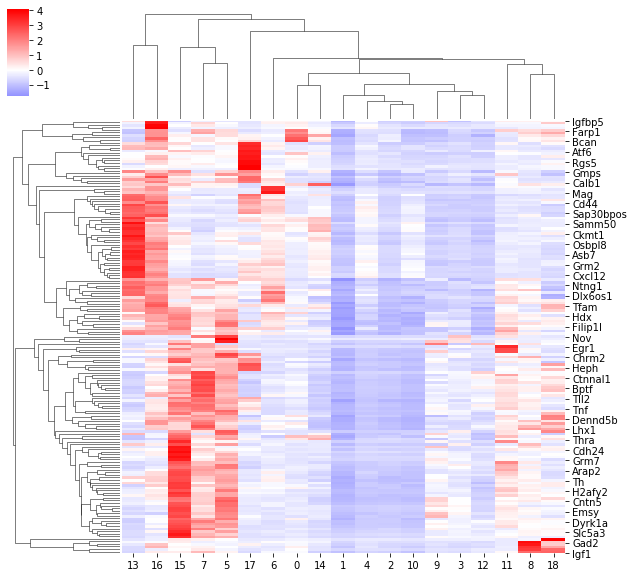

In [45]:
cell_type_matrix = pd.DataFrame(index=Merfish_scMatrix.columns)
for CT in MERFISH_clustered['louvain_r1'].unique():
    values = []
    temp = MERFISH_clustered[MERFISH_clustered['louvain_r1']==CT]
    for gene in Merfish_scMatrix.columns:
        values.append(np.average(temp[gene]))
    cell_type_matrix[CT] = values
sns.clustermap(cell_type_matrix,z_score=0,cmap='bwr',center=0)
plt.show()

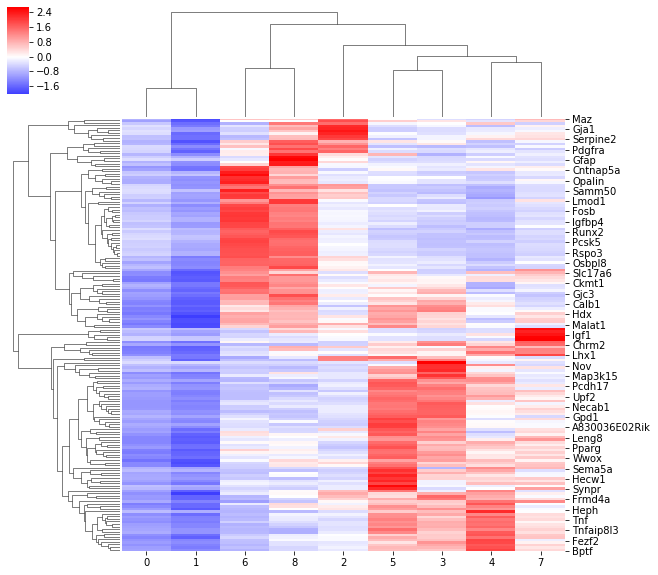

In [46]:
cell_type_matrix = pd.DataFrame(index=Merfish_scMatrix.columns)
for CT in MERFISH_clustered['louvain_r0.5'].unique():
    values = []
    temp = MERFISH_clustered[MERFISH_clustered['louvain_r0.5']==CT]
    for gene in Merfish_scMatrix.columns:
        values.append(np.average(temp[gene]))
    cell_type_matrix[CT] = values
sns.clustermap(cell_type_matrix,z_score=0,cmap='bwr',center=0)
plt.show()